In [1]:
# Import required libraries
import os
import gc
import sys
import json
import random
from pathlib import Path

import cv2 # CV2 for image manipulation
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

from tqdm import tqdm

from imgaug import augmenters as iaa

import seaborn as sns
import matplotlib.image as mpimg
from matplotlib import pyplot as plt

from sklearn.model_selection import StratifiedKFold, KFold


In [2]:
!pip install tensorflow==1.5
!pip install keras==2.1.5

import tensorflow
print(tensorflow.__version__)
import keras
print(keras.__version__)

     |████████████████████████████████| 44.4 MB 35.2 MB/s eta 0:00:01     |██████████████████████████████▏ | 41.9 MB 35.2 MB/s eta 0:00:01
     |████████████████████████████████| 3.0 MB 38.3 MB/s eta 0:00:01
     |████████████████████████████████| 889 kB 42.4 MB/s eta 0:00:01
  Created wheel for html5lib: filename=html5lib-0.9999999-py3-none-any.whl size=107220 sha256=c188335768133bc00c3757b7beccac4d2764c7a98d480269e4e6c66409b26909
  Stored in directory: /root/.cache/pip/wheels/90/1c/cb/a87fd097ff74648ecc468a703001f6c7c86d8a71d459e65c98
Successfully built html5lib
  Attempting uninstall: html5lib
    Found existing installation: html5lib 1.0.1
    Uninstalling html5lib-1.0.1:
      Successfully uninstalled html5lib-1.0.1
  Attempting uninstall: bleach
    Found existing installation: bleach 3.1.0
    Uninstalling bleach-3.1.0:
      Successfully uninstalled bleach-3.1.0
  Attempting uninstall: tensorflow
    Found existing installation: tensorflow 2.1.0
    Uninstalling tensorflow-2.1.

/opt/conda/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:493: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/opt/conda/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:494: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/opt/conda/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:495: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/opt/conda/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:496: FutureWarning: Passing (type, 1) or 

1.5.0
2.1.5


Using TensorFlow backend.


In [3]:
!ls /kaggle/input/imaterialist-fashion-2020-fgvc7/

label_descriptions.json  sample_submission.csv	test  train  train.csv


In [4]:
%%time
with open('/kaggle/input/imaterialist-fashion-2020-fgvc7/label_descriptions.json', 'r') as file:
    label_desc = json.load(file)
sample_sub_df = pd.read_csv('/kaggle/input/imaterialist-fashion-2020-fgvc7/sample_submission.csv')
train_df = pd.read_csv('/kaggle/input/imaterialist-fashion-2020-fgvc7/train.csv')

CPU times: user 10.6 s, sys: 1.72 s, total: 12.3 s
Wall time: 30.3 s


In [5]:
train_df.head()

,ImageId,EncodedPixels,Height,Width,ClassId,AttributesIds
0,00000663ed1ff0c4e0132b9b9ac53f6e,6068157 7 6073371 20 6078584 34 6083797 48 608...,5214,3676,6,"115,136,143,154,230,295,316,317"
1,00000663ed1ff0c4e0132b9b9ac53f6e,6323163 11 6328356 32 6333549 53 6338742 75 63...,5214,3676,0,"115,136,142,146,225,295,316,317"
2,00000663ed1ff0c4e0132b9b9ac53f6e,8521389 10 8526585 30 8531789 42 8537002 46 85...,5214,3676,28,163
3,00000663ed1ff0c4e0132b9b9ac53f6e,12903854 2 12909064 7 12914275 10 12919485 15 ...,5214,3676,31,"160,204"
4,00000663ed1ff0c4e0132b9b9ac53f6e,10837337 5 10842542 14 10847746 24 10852951 33...,5214,3676,32,219


In [6]:
sample_sub_df.head()

,ImageId,EncodedPixels,ClassId,AttributesIds
0,003d41dd20f271d27219fe7ee6de727d,1 1,0,"111,137"
1,0046f98599f05fd7233973e430d6d04d,1 1,0,"111,137"
2,004e9e21cd1aca568a8ffc77a54638ce,1 1,0,"111,137"
3,005b37fce3c0f641d327d95dd832f51b,1 1,0,"111,137"
4,0094940c58c343b742f48ae26eb5e9fa,1 1,0,"111,137"


In [7]:
print(f'Shape of training dataset: {train_df.shape}')

Shape of training dataset: (333401, 6)


In [8]:
print(f'# of images in training set: {train_df["ImageId"].nunique()}')
print(f'# of images in test set: {sample_sub_df["ImageId"].nunique()}')

# of images in training set: 45623
# of images in test set: 3200


### Image size analysis in training dataset

In [9]:
pd.DataFrame([train_df['Height'].describe(), train_df['Width'].describe()]).T.loc[['max', 'min', 'mean']]

,Height,Width
max,8688.000000,10717.00000
min,296.000000,151.00000
mean,2235.524021,1761.97925


### Height and Width destribution of training images

In [10]:
image_shape_df = train_df.groupby("ImageId")["Height", "Width"].first()

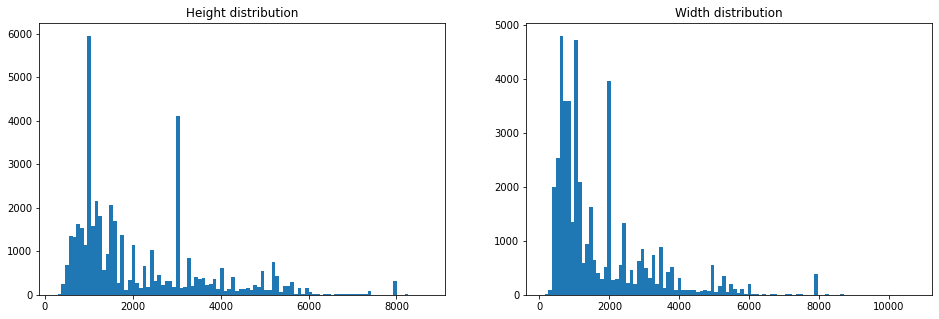

In [11]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 5))
ax1.hist(image_shape_df['Height'], bins=100)
ax1.set_title("Height distribution")
ax2.hist(image_shape_df['Width'], bins=100)
ax2.set_title("Width distribution")
plt.show()

### Image with minimum height

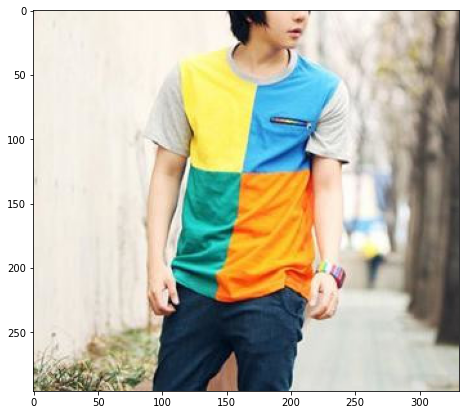

In [12]:
plt.figure(figsize = (70,7))
min_height = list(set(train_df[train_df['Height'] == train_df['Height'].min()]['ImageId']))[0]
plt.imshow(mpimg.imread(f'/kaggle/input/imaterialist-fashion-2020-fgvc7/train/{min_height}.jpg'))
plt.grid(False)
plt.show()

### Image with maximum height

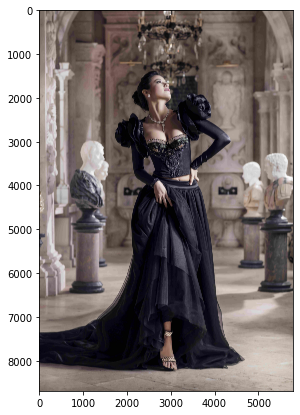

In [13]:
plt.figure(figsize = (70,7))
max_height = list(set(train_df[train_df['Height'] == train_df['Height'].max()]['ImageId']))[0]
plt.imshow(mpimg.imread(f'/kaggle/input/imaterialist-fashion-2020-fgvc7/train/{max_height}.jpg'))
plt.grid(False)
plt.show()

### Image with minimum width

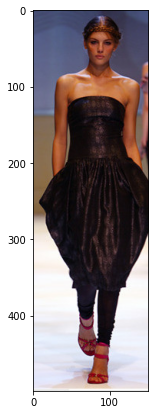

In [14]:
plt.figure(figsize = (70,7))
min_width = list(set(train_df[train_df['Width'] == train_df['Width'].min()]['ImageId']))[0]
plt.imshow(mpimg.imread(f'/kaggle/input/imaterialist-fashion-2020-fgvc7/train/{min_width}.jpg'))
plt.grid(False)
plt.show()

### Image with maximum width

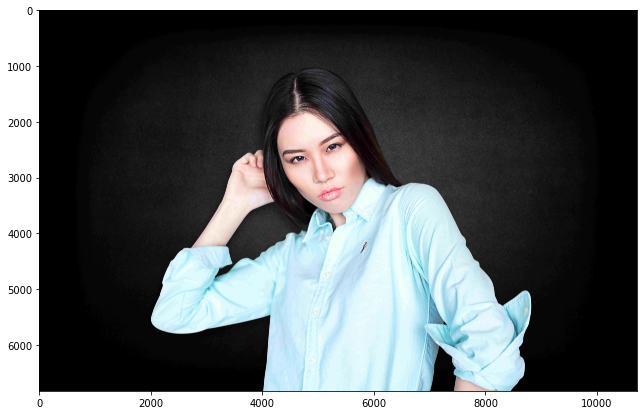

In [15]:
plt.figure(figsize = (70,7))
max_width = list(set(train_df[train_df['Width'] == train_df['Width'].max()]['ImageId']))[0]
plt.imshow(mpimg.imread(f'/kaggle/input/imaterialist-fashion-2020-fgvc7/train/{max_width}.jpg'))
plt.grid(False)
plt.show()

In [16]:
area_df = pd.DataFrame()
area_df['ImageId'] = train_df['ImageId']
area_df['area'] = train_df['Height'] * train_df['Width']
min_area = list(set(area_df[area_df['area'] == area_df['area'].min()]['ImageId']))[0]
max_area = list(set(area_df[area_df['area'] == area_df['area'].max()]['ImageId']))[0]

### Image with minimum area

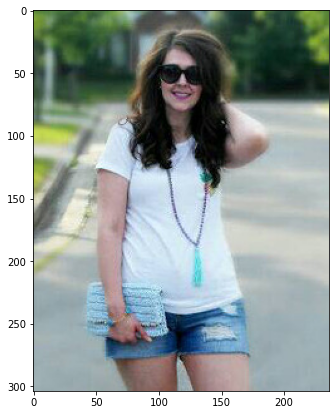

In [17]:
plt.figure(figsize = (70,7))
plt.imshow(mpimg.imread(f'/kaggle/input/imaterialist-fashion-2020-fgvc7/train/{min_area}.jpg'))
plt.grid(False)
plt.show()

### Image with maximum area

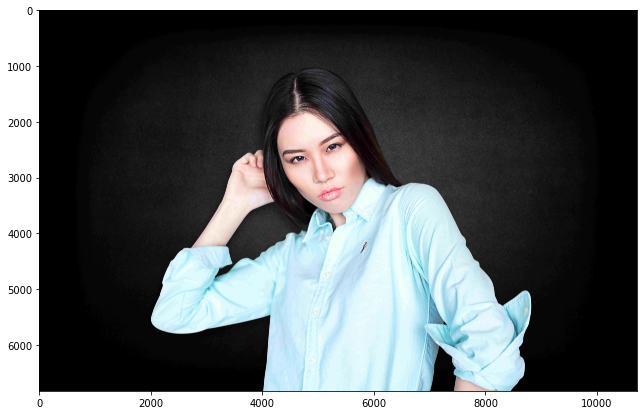

In [18]:
plt.figure(figsize = (70,7))
plt.imshow(mpimg.imread(f'/kaggle/input/imaterialist-fashion-2020-fgvc7/train/{max_area}.jpg'))
plt.grid(False)
plt.show()

## Details about Classes and Attributes

In [19]:
num_classes = len(label_desc['categories'])
num_attributes = len(label_desc['attributes'])
print(f'Total # of classes: {num_classes}')
print(f'Total # of attributes: {num_attributes}')

Total # of classes: 46
Total # of attributes: 294


In [20]:
categories_df = pd.DataFrame(label_desc['categories'])
attributes_df = pd.DataFrame(label_desc['attributes'])
categories_df

,id,name,supercategory,level
0,0,"shirt, blouse",upperbody,2
1,1,"top, t-shirt, sweatshirt",upperbody,2
2,2,sweater,upperbody,2
3,3,cardigan,upperbody,2
4,4,jacket,upperbody,2
5,5,vest,upperbody,2
6,6,pants,lowerbody,2
7,7,shorts,lowerbody,2
8,8,skirt,lowerbody,2
9,9,coat,wholebody,2


In [21]:
pd.set_option('display.max_rows', 300)
attributes_df

,id,name,supercategory,level
0,0,classic (t-shirt),nickname,1
1,1,polo (shirt),nickname,1
2,2,undershirt,nickname,1
3,3,henley (shirt),nickname,1
4,4,ringer (t-shirt),nickname,1
5,5,raglan (t-shirt),nickname,1
6,6,rugby (shirt),nickname,1
7,7,sailor (shirt),nickname,1
8,8,crop (top),nickname,1
9,9,halter (top),nickname,1


## Plotting a few training images without any masks

In [22]:
def plot_images(size=12, figsize=(12, 12)):
    # First get some images to be plotted
    image_ids = train_df['ImageId'].unique()[:12]
    images=[]
    
    for image in image_ids:
        images.append(mpimg.imread(f'/kaggle/input/imaterialist-fashion-2020-fgvc7/train/{image}.jpg'))
    
    # Plot images in groups of 4 images
    n_groups = 4
    
    count = 0
    for index in range(size // 4):
        fig, ax = plt.subplots(nrows=2, ncols=2, figsize=figsize)
        for row in ax:
            for col in row:
                col.imshow(images[count])
                col.axis('off')
                count += 1
        plt.show()
    gc.collect()

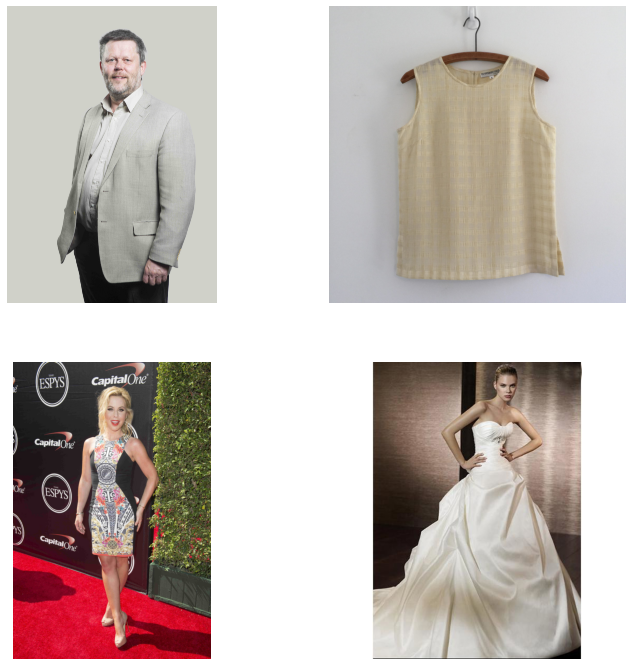

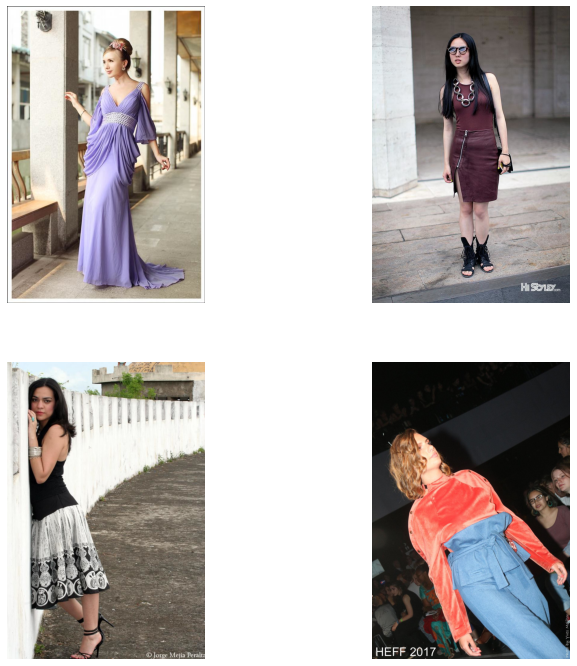

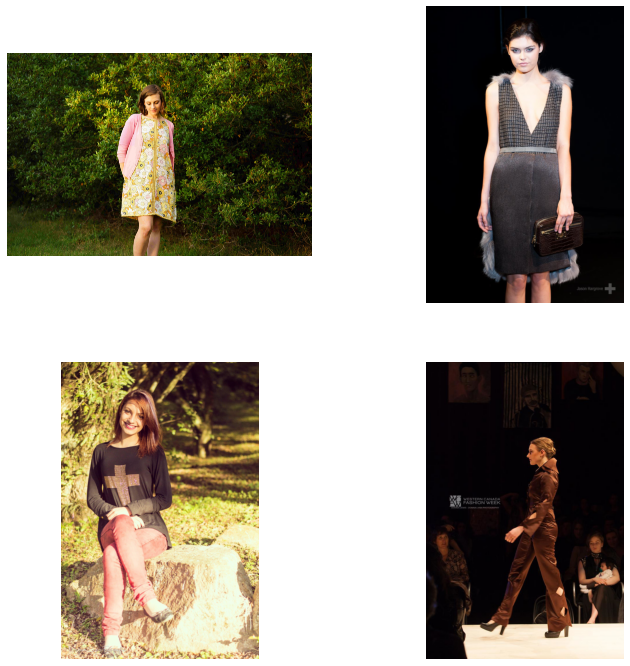

In [23]:
plot_images()

## Plotting a few images with given segments

In [24]:
def create_mask(size):
    image_ids = train_df['ImageId'].unique()[:size]
    images_meta=[]

    for image_id in image_ids:
        img = mpimg.imread(f'/kaggle/input/imaterialist-fashion-2020-fgvc7/train/{image_id}.jpg')
        images_meta.append({
            'image': img,
            'shape': img.shape,
            'encoded_pixels': train_df[train_df['ImageId'] == image_id]['EncodedPixels'],
            'class_ids':  train_df[train_df['ImageId'] == image_id]['ClassId']
        })

    masks = []
    for image in images_meta:
        shape = image.get('shape')
        encoded_pixels = list(image.get('encoded_pixels'))
        class_ids = list(image.get('class_ids'))
        
        # Initialize numpy array with shape same as image size
        height, width = shape[:2]
        mask = np.zeros((height, width)).reshape(-1)
        
        # Iterate over encoded pixels and create mask
        for segment, (pixel_str, class_id) in enumerate(zip(encoded_pixels, class_ids)):
            splitted_pixels = list(map(int, pixel_str.split()))
            pixel_starts = splitted_pixels[::2]
            run_lengths = splitted_pixels[1::2]
            assert max(pixel_starts) < mask.shape[0]
            for pixel_start, run_length in zip(pixel_starts, run_lengths):
                pixel_start = int(pixel_start) - 1
                run_length = int(run_length)
                mask[pixel_start:pixel_start+run_length] = 255 - class_id * 4
        masks.append(mask.reshape((height, width), order='F'))  # https://stackoverflow.com/questions/45973722/how-does-numpy-reshape-with-order-f-work
    return masks, images_meta

In [25]:
def plot_segmented_images(size=12, figsize=(14, 14)):
    # First create masks from given segments
    masks, images_meta = create_mask(size)
    
    # Plot images in groups of 4 images
    n_groups = 4
    
    count = 0
    for index in range(size // 4):
        fig, ax = plt.subplots(nrows=2, ncols=2, figsize=figsize)
        for row in ax:
            for col in row:
                col.imshow(images_meta[count]['image'])
                col.imshow(masks[count], alpha=0.75)
                col.axis('off')
                count += 1
        plt.show()
    gc.collect()

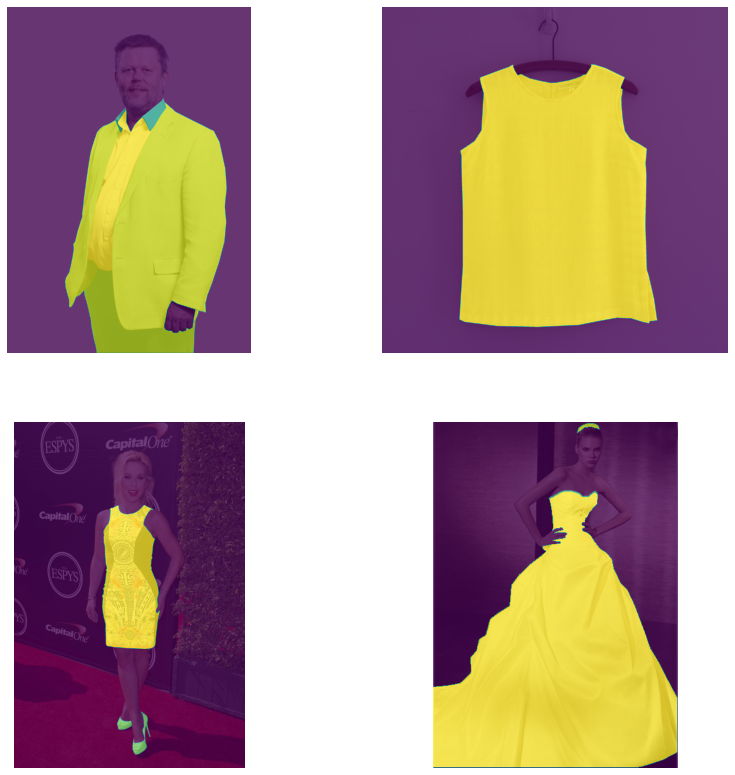

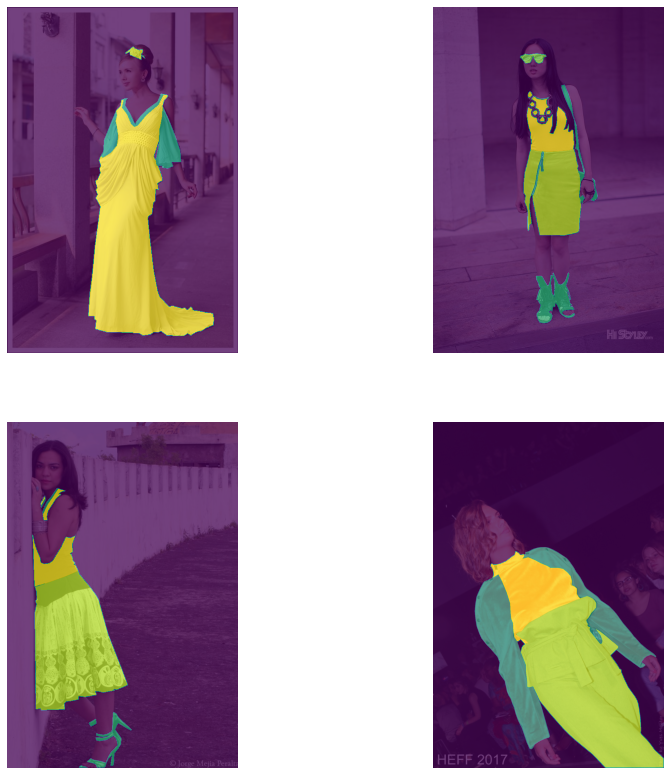

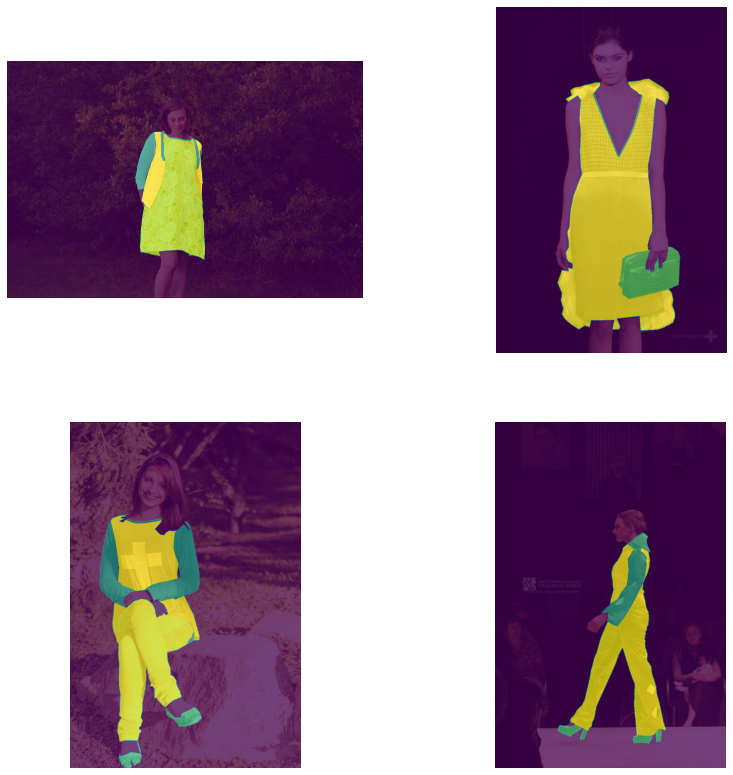

In [26]:
plot_segmented_images()

## Analysing Categories and Attributes

In [27]:
categories_df = pd.DataFrame(label_desc.get('categories'))
attributes_df = pd.DataFrame(label_desc.get('attributes'))

In [28]:
print(f'# of categories: {len(categories_df)}')
print(f'# of attributes: {len(attributes_df)}')

# of categories: 46
# of attributes: 294


So there are 46 categories (classes) and 294 attributes. Let's see some of the categories and attributes

In [29]:
categories_df.head()

,id,name,supercategory,level
0,0,"shirt, blouse",upperbody,2
1,1,"top, t-shirt, sweatshirt",upperbody,2
2,2,sweater,upperbody,2
3,3,cardigan,upperbody,2
4,4,jacket,upperbody,2


In [30]:
attributes_df.head()

,id,name,supercategory,level
0,0,classic (t-shirt),nickname,1
1,1,polo (shirt),nickname,1
2,2,undershirt,nickname,1
3,3,henley (shirt),nickname,1
4,4,ringer (t-shirt),nickname,1


In [31]:
category_map, attribute_map = {}, {}
for cat in label_desc.get('categories'):
    category_map[cat.get('id')] = cat.get('name')
for attr in label_desc.get('attributes'):
    attribute_map[attr.get('id')] = attr.get('name')

In [32]:
train_df['ClassId'] = train_df['ClassId'].map(category_map)
train_df['ClassId'] = train_df['ClassId'].astype('category')

### Let's see the class wise distribution of segments in training dataset

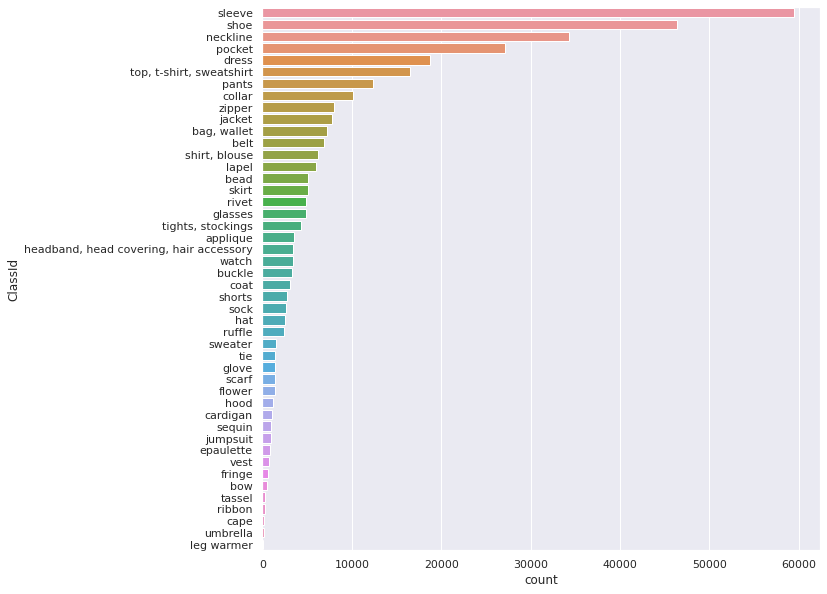

In [33]:
sns.set(style='darkgrid')
fig, ax = plt.subplots(figsize = (10,10))
sns.countplot(y='ClassId',data=train_df , ax=ax, order = train_df['ClassId'].value_counts().index)
fig.show()

### Now let's visualize an image with all its classes and attributes

In [34]:
IMAGE_ID = '000b3ec2c6eaffb491a5abb72c2e3e26'

In [35]:
# Get the an image id given in the training set for visualization
vis_df = train_df[train_df['ImageId'] == IMAGE_ID]
vis_df['ClassId'] = vis_df['ClassId'].cat.codes
vis_df = vis_df.reset_index(drop=True)
vis_df

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


,ImageId,EncodedPixels,Height,Width,ClassId,AttributesIds
0,000b3ec2c6eaffb491a5abb72c2e3e26,752989 6 755294 19 757599 31 759904 44 762209 ...,2310,1536,32,NaN
1,000b3ec2c6eaffb491a5abb72c2e3e26,1468756 2 1471067 9 1473378 15 1475689 21 1478...,2310,1536,32,NaN
2,000b3ec2c6eaffb491a5abb72c2e3e26,701292 5 703597 15 705903 25 708209 34 710515 ...,2310,1536,24,"115,135,154,230,295,316,317"
3,000b3ec2c6eaffb491a5abb72c2e3e26,458445 17 460731 51 463017 85 465303 115 46759...,2310,1536,41,"0,115,136,145,147,295,314,317"
4,000b3ec2c6eaffb491a5abb72c2e3e26,1787118 1 1789427 1 1791735 3 1794044 3 179635...,2310,1536,25,218
5,000b3ec2c6eaffb491a5abb72c2e3e26,1139954 1 1142264 1 1144573 2 1146882 3 114919...,2310,1536,35,"160,204"
6,000b3ec2c6eaffb491a5abb72c2e3e26,458445 17 460731 51 463017 85 465303 115 46759...,2310,1536,35,"160,204"
7,000b3ec2c6eaffb491a5abb72c2e3e26,839153 2 841462 6 843771 10 846081 12 848390 1...,2310,1536,23,190


From above table, this image has 8 segmentes and a few attributes. Let's visualize all of them!

## Let's first the plot the plain image

[]

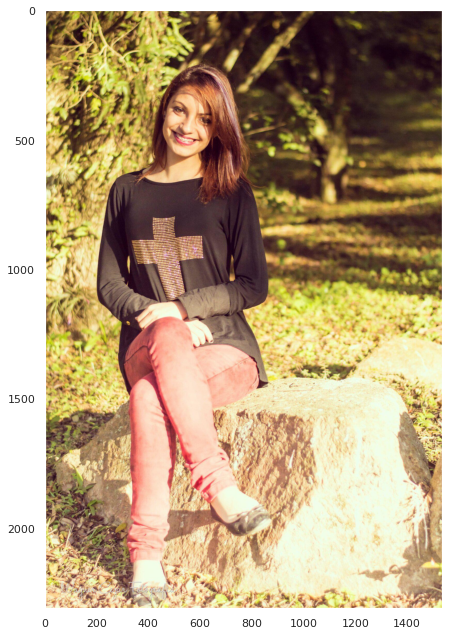

In [36]:
plt.figure(figsize = (110,11))
image = mpimg.imread(f'/kaggle/input/imaterialist-fashion-2020-fgvc7/train/{IMAGE_ID}.jpg')
plt.grid(False)
plt.imshow(image)
plt.plot()

In [37]:
train_df[train_df['ImageId'] == IMAGE_ID]

,ImageId,EncodedPixels,Height,Width,ClassId,AttributesIds
51,000b3ec2c6eaffb491a5abb72c2e3e26,752989 6 755294 19 757599 31 759904 44 762209 ...,2310,1536,shoe,NaN
52,000b3ec2c6eaffb491a5abb72c2e3e26,1468756 2 1471067 9 1473378 15 1475689 21 1478...,2310,1536,shoe,NaN
53,000b3ec2c6eaffb491a5abb72c2e3e26,701292 5 703597 15 705903 25 708209 34 710515 ...,2310,1536,pants,"115,135,154,230,295,316,317"
54,000b3ec2c6eaffb491a5abb72c2e3e26,458445 17 460731 51 463017 85 465303 115 46759...,2310,1536,"top, t-shirt, sweatshirt","0,115,136,145,147,295,314,317"
55,000b3ec2c6eaffb491a5abb72c2e3e26,1787118 1 1789427 1 1791735 3 1794044 3 179635...,2310,1536,pocket,218
56,000b3ec2c6eaffb491a5abb72c2e3e26,1139954 1 1142264 1 1144573 2 1146882 3 114919...,2310,1536,sleeve,"160,204"
57,000b3ec2c6eaffb491a5abb72c2e3e26,458445 17 460731 51 463017 85 465303 115 46759...,2310,1536,sleeve,"160,204"
58,000b3ec2c6eaffb491a5abb72c2e3e26,839153 2 841462 6 843771 10 846081 12 848390 1...,2310,1536,neckline,190


## Now let's plot each segment in a separate image

In [38]:
segments = list(vis_df['EncodedPixels'])
class_ids = list(vis_df['ClassId'])
masks = []
for segment, class_id in zip(segments, class_ids):
    
    height = vis_df['Height'][0]
    width = vis_df['Width'][0]
    # Initialize empty mask
    mask = np.zeros((height, width)).reshape(-1)
    
    # Iterating over encoded pixels and creating mask
    splitted_pixels = list(map(int, segment.split()))
    pixel_starts = splitted_pixels[::2]
    run_lengths = splitted_pixels[1::2]
    assert max(pixel_starts) < mask.shape[0]
    for pixel_start, run_length in zip(pixel_starts, run_lengths):
        pixel_start = int(pixel_start) - 1
        run_length = int(run_length)
        mask[pixel_start:pixel_start+run_length] = 255 - class_id * 4

    mask = mask.reshape((height, width), order='F')
    masks.append(mask)

In [39]:
def plot_individual_segment(*masks, image, figsize=(110, 11)):
    plt.figure(figsize = figsize)
    plt.imshow(image)
    for mask in masks:
        plt.imshow(mask, alpha=0.6)
    plt.axis('off')
    plt.show()

## Plotting 1st Segment: ClassId: "Shoe" and no attributes 

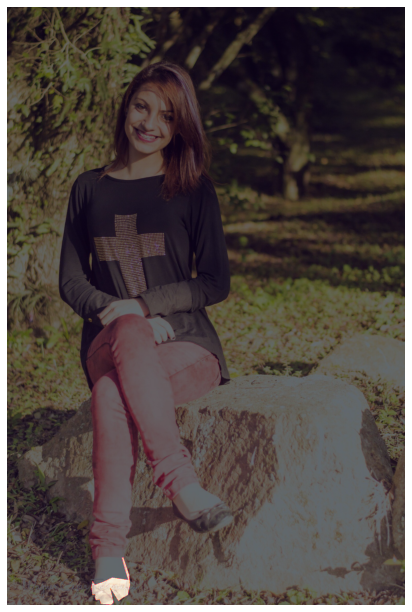

In [40]:
plot_individual_segment(masks[0], image=image)

## Plotting 2nd Segment: ClassId: "shoe"

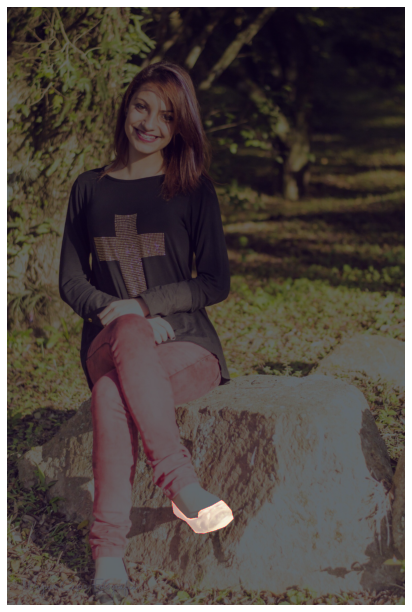

In [41]:
plot_individual_segment(masks[1], image=image)

## Plotting 3rd Segment with ClassId: "pants"

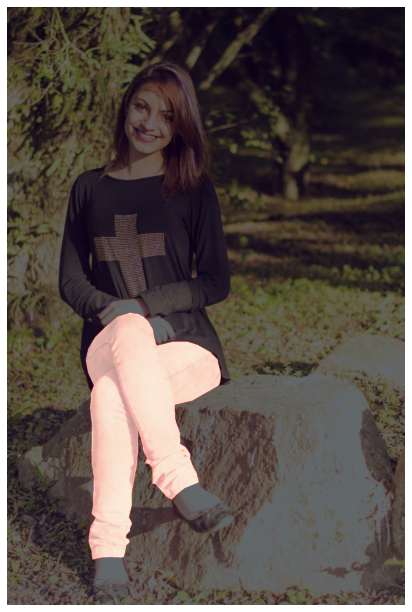

In [42]:
plot_individual_segment(masks[2], image=image)

## Plotting 4th Segment with ClassId: "top, t-shirt, sweatshirt"

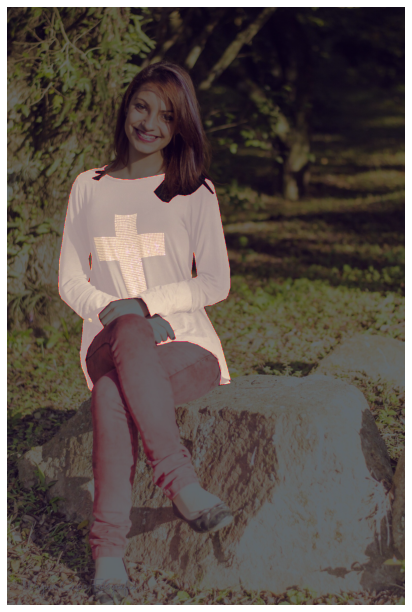

In [43]:
plot_individual_segment(masks[3], image=image)

## Plotting 5th Segment with ClassId: "pocket"

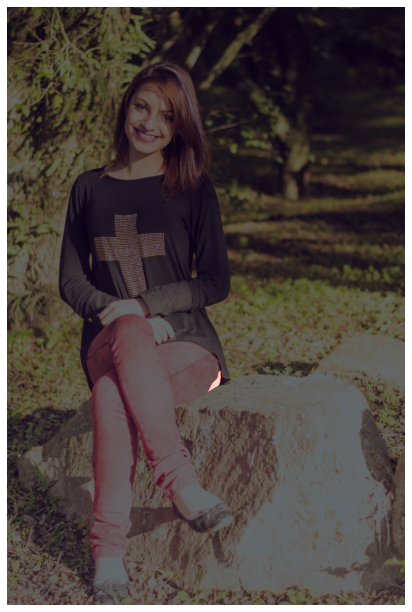

In [44]:
plot_individual_segment(masks[4], image=image)

## Plotting 6th Segment with ClassId: "sleeve"

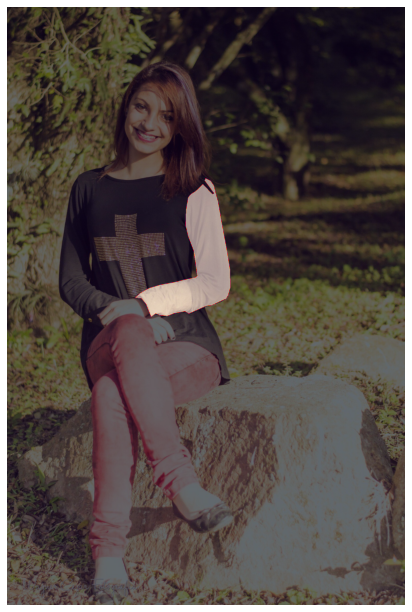

In [45]:
plot_individual_segment(masks[5], image=image)

## Plotting 7th Segment with ClassId: "sleeve"

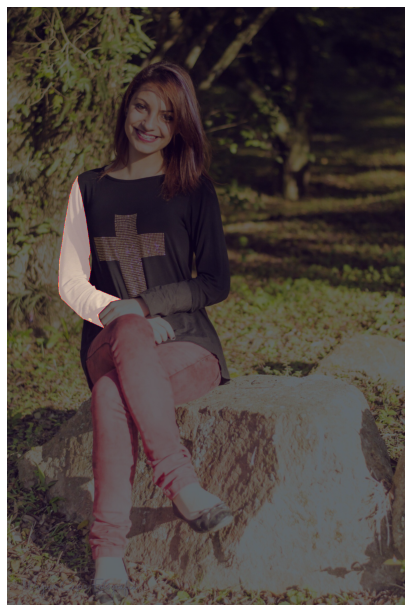

In [46]:
plot_individual_segment(masks[6], image=image)

## Plotting 8th segment with Class "neckline"

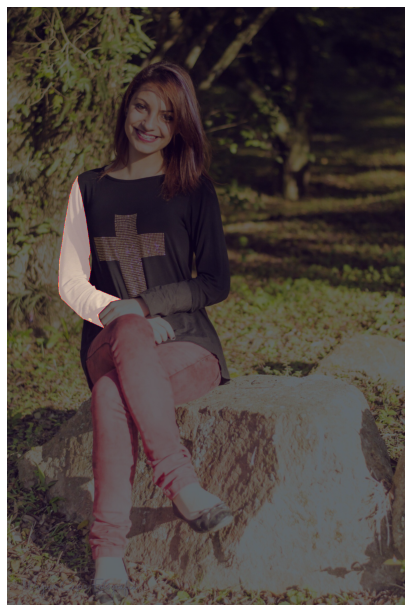

In [47]:
plot_individual_segment(masks[6], image=image)

Some of the segments have no attributes. Let's check how many such segment exists in training dataset.

In [48]:
print(f'Segments that do not have attributes: {train_df["AttributesIds"].isna().sum()/len(train_df) * 100} %')

Segments that do not have attributes: 38.089567817733 %


Let's check of missing values in training dataset for columns other than "AttributeIds"

In [49]:
train_df[['ImageId', 'EncodedPixels', 'Height', 'Width', 'ClassId']].isna().sum()

ImageId          0
EncodedPixels    0
Height           0
Width            0
ClassId          0
dtype: int64

## Data Preparation and modeling

In [50]:
train_df

,ImageId,EncodedPixels,Height,Width,ClassId,AttributesIds
0,00000663ed1ff0c4e0132b9b9ac53f6e,6068157 7 6073371 20 6078584 34 6083797 48 608...,5214,3676,pants,"115,136,143,154,230,295,316,317"
1,00000663ed1ff0c4e0132b9b9ac53f6e,6323163 11 6328356 32 6333549 53 6338742 75 63...,5214,3676,"shirt, blouse","115,136,142,146,225,295,316,317"
2,00000663ed1ff0c4e0132b9b9ac53f6e,8521389 10 8526585 30 8531789 42 8537002 46 85...,5214,3676,collar,163
3,00000663ed1ff0c4e0132b9b9ac53f6e,12903854 2 12909064 7 12914275 10 12919485 15 ...,5214,3676,sleeve,"160,204"
4,00000663ed1ff0c4e0132b9b9ac53f6e,10837337 5 10842542 14 10847746 24 10852951 33...,5214,3676,pocket,219
...,...,...,...,...,...,...
333396,fffe20b555b98c3c1f26c8dfff275cbc,2712731 8 2715725 23 2718719 39 2721713 55 272...,3000,2001,collar,163
333397,ffffbf7014a9e408bfbb81a75bc70638,71179 1 71678 3 72178 4 72678 4 73178 5 73679 ...,500,375,neckline,NaN
333398,ffffbf7014a9e408bfbb81a75bc70638,116648 5 117148 16 117648 22 118148 26 118647 ...,500,375,sleeve,157
333399,ffffbf7014a9e408bfbb81a75bc70638,67711 1 68210 1 68709 2 69204 2 69208 3 69705 ...,500,375,sleeve,157


In [51]:
train_df['ClassId'] = train_df['ClassId'].cat.codes

In [52]:
train_df

,ImageId,EncodedPixels,Height,Width,ClassId,AttributesIds
0,00000663ed1ff0c4e0132b9b9ac53f6e,6068157 7 6073371 20 6078584 34 6083797 48 608...,5214,3676,24,"115,136,143,154,230,295,316,317"
1,00000663ed1ff0c4e0132b9b9ac53f6e,6323163 11 6328356 32 6333549 53 6338742 75 63...,5214,3676,31,"115,136,142,146,225,295,316,317"
2,00000663ed1ff0c4e0132b9b9ac53f6e,8521389 10 8526585 30 8531789 42 8537002 46 85...,5214,3676,9,163
3,00000663ed1ff0c4e0132b9b9ac53f6e,12903854 2 12909064 7 12914275 10 12919485 15 ...,5214,3676,35,"160,204"
4,00000663ed1ff0c4e0132b9b9ac53f6e,10837337 5 10842542 14 10847746 24 10852951 33...,5214,3676,25,219
...,...,...,...,...,...,...
333396,fffe20b555b98c3c1f26c8dfff275cbc,2712731 8 2715725 23 2718719 39 2721713 55 272...,3000,2001,9,163
333397,ffffbf7014a9e408bfbb81a75bc70638,71179 1 71678 3 72178 4 72678 4 73178 5 73679 ...,500,375,23,NaN
333398,ffffbf7014a9e408bfbb81a75bc70638,116648 5 117148 16 117648 22 118148 26 118647 ...,500,375,35,157
333399,ffffbf7014a9e408bfbb81a75bc70638,67711 1 68210 1 68709 2 69204 2 69208 3 69705 ...,500,375,35,157


Drop attributeIds for simplicity for now. TODO: Need to take this in consideration once the basic model is ready with ClassId

In [53]:
train_df = train_df.drop('AttributesIds', axis=1)

In [54]:
image_df = train_df.groupby('ImageId')['EncodedPixels', 'ClassId'].agg(lambda x: list(x))
size_df = train_df.groupby('ImageId')['Height', 'Width'].mean()
image_df = image_df.join(size_df, on='ImageId')

print("Total images: ", len(image_df))
image_df.head()

Total images:  45623


,EncodedPixels,ClassId,Height,Width
ImageId,,,,
00000663ed1ff0c4e0132b9b9ac53f6e,[6068157 7 6073371 20 6078584 34 6083797 48 60...,"[24, 31, 9, 35, 25, 25, 35, 21, 19]",5214,3676
0000fe7c9191fba733c8a69cfaf962b7,[2201176 1 2203623 3 2206071 5 2208518 8 22109...,"[23, 41]",2448,2448
0002ec21ddb8477e98b2cbb87ea2e269,[2673735 2 2676734 8 2679734 13 2682733 19 268...,"[23, 10, 32, 32]",3000,1997
0002f5a0ebc162ecfb73e2c91e3b8f62,[435 132 1002 132 1569 132 2136 132 2703 132 3...,"[10, 23, 17]",567,400
0004467156e47b0eb6de4aa6479cbd15,[132663 8 133396 25 134130 41 134868 53 135611...,"[10, 23, 35, 35, 17]",750,500


Reference: https://github.com/matterport/Mask_RCNN/blob/master/samples/shapes/train_shapes.ipynb

In [55]:
import os
from pathlib import Path
!git clone https://www.github.com/matterport/Mask_RCNN.git
os.chdir('Mask_RCNN')

!rm -rf .git # to prevent an error when the kernel is committed
!rm -rf images assets # to prevent displaying images at the bottom of a kernel

Cloning into 'Mask_RCNN'...
remote: Enumerating objects: 956, done.
remote: Total 956 (delta 0), reused 0 (delta 0), pack-reused 956
Receiving objects: 100% (956/956), 137.67 MiB | 38.81 MiB/s, done.
Resolving deltas: 100% (558/558), done.


In [56]:
!wget --quiet https://github.com/matterport/Mask_RCNN/releases/download/v2.0/mask_rcnn_coco.h5
!ls -lh mask_rcnn_coco.h5

COCO_WEIGHTS_PATH = 'mask_rcnn_coco.h5'

-rw-r--r-- 1 root root 246M Dec  6  2021 mask_rcnn_coco.h5


In [57]:
#!cat /kaggle/working/Mask_RCNN/mrcnn/model.py

In [58]:
DATA_DIR = Path('/kaggle/input/imaterialist-fashion-2020-fgvc7')
ROOT_DIR = Path('/kaggle/working')

In [59]:
import sys

In [60]:
sys.path = sys.path[:-1]

In [61]:
sys.path.append(ROOT_DIR/'Mask_RCNN')
from mrcnn.config import Config
from mrcnn import utils
import mrcnn.model as modellib
from mrcnn import visualize
from mrcnn.model import log

In [62]:
class FashionConfig(Config):
    """Configuration for training on the toy shapes dataset.
    Derives from the base Config class and overrides values specific
    to the toy shapes dataset.
    """
    # Give the configuration a recognizable name
    NAME = "class"

    # Train on 1 GPU and 8 images per GPU. We can put multiple images on each
    # GPU because the images are small. Batch size is 8 (GPUs * images/GPU).
    GPU_COUNT = 1
    #changed batch size to 4
    IMAGES_PER_GPU = 1
    BACKBONE = 'resnet50'
    # Number of classes (including background)
    NUM_CLASSES = 1 + len(categories_df)  # background + 46 classes

    # Use small images for faster training. Set the limits of the small side
    # the large side, and that determines the image shape.
    IMAGE_MIN_DIM = 256
    IMAGE_MAX_DIM = 256

    # Use smaller anchors because our image and objects are small
    RPN_ANCHOR_SCALES = (8, 16, 32, 64, 128)  # anchor side in pixels

    # Reduce training ROIs per image because the images are small and have
    # few objects. Aim to allow ROI sampling to pick 33% positive ROIs.
    TRAIN_ROIS_PER_IMAGE = 32

    # Use a small epoch since the data is simple
    STEPS_PER_EPOCH = 100

    # use small validation steps since the epoch is small
    VALIDATION_STEPS = 5
    
config = FashionConfig()
config.display()


Configurations:
BACKBONE                       resnet50
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.7
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  256
IMAGE_META_SIZE                59
IMAGE_MIN_DIM                  256
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [256 256   3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE              

In [63]:
class FashionDataset(utils.Dataset):
    def __init__(self, df):
        super().__init__(self)
        
        self.IMAGE_SIZE = 256
        
        # Add classes
        for cat in label_desc['categories']:
            self.add_class('fashion', cat.get('id'), cat.get('name'))
        
        # Add images
        for i, row in df.iterrows():
            self.add_image("fashion", 
                           image_id=row.name, 
                           path=str(DATA_DIR/'train'/row.name) + '.jpg', 
                           labels=row['ClassId'],
                           annotations=row['EncodedPixels'], 
                           height=row['Height'], width=row['Width'])
            
    def _resize_image(self, image_path):
        img = cv2.imread(image_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (self.IMAGE_SIZE, self.IMAGE_SIZE), interpolation=cv2.INTER_AREA)  
        return img
        
    def load_image(self, image_id):
        return self._resize_image(self.image_info[image_id]['path'])
    
    def image_reference(self, image_id):
        info = self.image_info[image_id]
        return info['path'], [x for x in info['labels']]
    
    def load_mask(self, image_id):
        info = self.image_info[image_id]
                
        mask = np.zeros((self.IMAGE_SIZE, self.IMAGE_SIZE, len(info['annotations'])), dtype=np.uint8)
        labels = []
        
        for m, (annotation, label) in enumerate(zip(info['annotations'], info['labels'])):
            sub_mask = np.full(info['height']*info['width'], 0, dtype=np.uint8)
            annotation = [int(x) for x in annotation.split(' ')]
            
            for i, start_pixel in enumerate(annotation[::2]):
                sub_mask[start_pixel: start_pixel+annotation[2*i+1]] = 1

            sub_mask = sub_mask.reshape((info['height'], info['width']), order='F')
            sub_mask = cv2.resize(sub_mask, (self.IMAGE_SIZE, self.IMAGE_SIZE), interpolation=cv2.INTER_NEAREST)
            
            mask[:, :, m] = sub_mask
            labels.append(int(label)+1)
            
        return mask, np.array(labels)

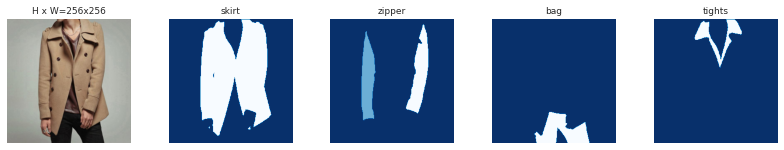

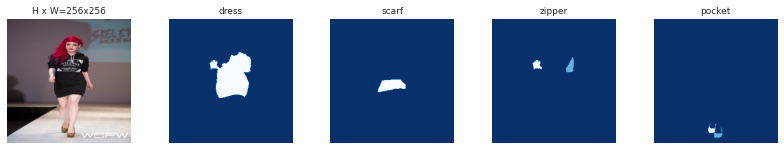

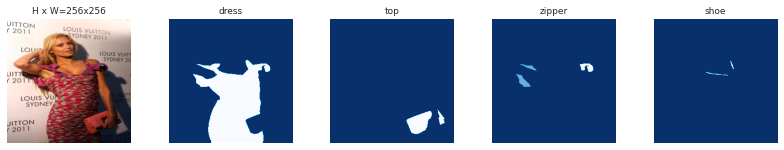

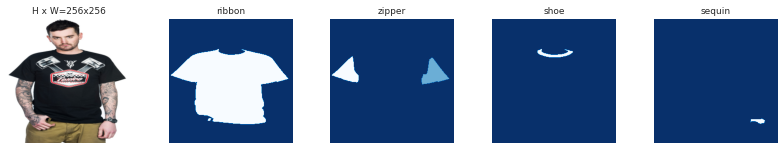

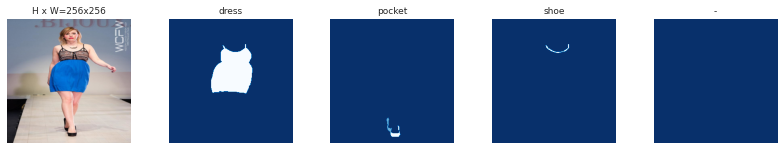

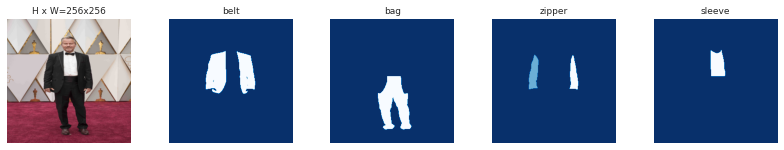

In [64]:
dataset = FashionDataset(image_df)
dataset.prepare()

for i in range(6):
    image_id = random.choice(dataset.image_ids)

    image = dataset.load_image(image_id)
    mask, class_ids = dataset.load_mask(image_id)
    visualize.display_top_masks(image, mask, class_ids, dataset.class_names, limit=4)

In [65]:
# Training on a very small subset of the data for fast results for now.
# image_df = image_df.iloc[0:2]

In [66]:
# This code partially supports k-fold training, 
# you can specify the fold to train and the total number of folds here
FOLD = 0
N_FOLDS = 2

kf = KFold(n_splits=N_FOLDS, random_state=42, shuffle=True)
splits = kf.split(image_df) # ideally, this should be multilabel stratification

def get_fold():    
    for i, (train_index, valid_index) in enumerate(splits):
        if i == FOLD:
            return image_df.iloc[train_index], image_df.iloc[valid_index]
        
train_df, valid_df = get_fold()

train_dataset = FashionDataset(train_df)
train_dataset.prepare()

valid_dataset = FashionDataset(valid_df)
valid_dataset.prepare()

In [67]:
print(train_df.shape)
print(valid_df.shape)

(22811, 4)
(22812, 4)


## Training

In [68]:
# Note that any hyperparameters here, such as LR, may still not be optimal
LR = 1e-4
EPOCHS = [10, 14, 18, 22]

import warnings 
warnings.filterwarnings("ignore")

Let's load the COCO dataset weights to our Model.

In [69]:
model = modellib.MaskRCNN(mode='training', config=config, model_dir=ROOT_DIR)

# Load weights trained on MS COCO, but skip layers that
# are different due to the different number of classes
# See README for instructions to download the COCO weights
model.load_weights(COCO_WEIGHTS_PATH, by_name=True,
                   exclude=["mrcnn_class_logits", "mrcnn_bbox_fc", 
                            "mrcnn_bbox", "mrcnn_mask"])

In [70]:

model.train(train_dataset, valid_dataset,
           learning_rate=LR*2, # train heads with higher lr to speedup learning
           epochs=EPOCHS[0],
           layers='heads',
           augmentation=None)

history = model.keras_model.history.history


Starting at epoch 0. LR=0.0002

Checkpoint Path: /kaggle/working/class20230304T0318/mask_rcnn_class_{epoch:04d}.h5
Selecting layers to train
fpn_c5p5               (Conv2D)
fpn_c4p4               (Conv2D)
fpn_c3p3               (Conv2D)
fpn_c2p2               (Conv2D)
fpn_p5                 (Conv2D)
fpn_p2                 (Conv2D)
fpn_p3                 (Conv2D)
fpn_p4                 (Conv2D)
In model:  rpn_model
    rpn_conv_shared        (Conv2D)
    rpn_class_raw          (Conv2D)
    rpn_bbox_pred          (Conv2D)
mrcnn_mask_conv1       (TimeDistributed)
mrcnn_mask_bn1         (TimeDistributed)
mrcnn_mask_conv2       (TimeDistributed)
mrcnn_mask_bn2         (TimeDistributed)
mrcnn_class_conv1      (TimeDistributed)
mrcnn_class_bn1        (TimeDistributed)
mrcnn_mask_conv3       (TimeDistributed)
mrcnn_mask_bn3         (TimeDistributed)
mrcnn_class_conv2      (TimeDistributed)
mrcnn_class_bn2        (TimeDistributed)
mrcnn_mask_conv4       (TimeDistributed)
mrcnn_mask_bn4        

In [71]:
# %%time
# model.train(train_dataset, valid_dataset,
#             learning_rate=LR,
#             epochs=EPOCHS[1],
#             layers='all',
#             augmentation=iaa.SomeOf((0, 2), [
              #iaa.Fliplr(0.5),
              #iaa.Flipud(0.5),]))

# new_history = model.keras_model.history.history
# for k in new_history: history[k] = history[k] + new_history[k]

In [72]:
%%time
model.train(train_dataset, valid_dataset,
            learning_rate=LR/5,
            epochs=EPOCHS[2],
            layers='all',
            augmentation=None)

new_history = model.keras_model.history.history
for k in new_history: history[k] = history[k] + new_history[k]


Starting at epoch 10. LR=2e-05

Checkpoint Path: /kaggle/working/class20230304T0318/mask_rcnn_class_{epoch:04d}.h5
Selecting layers to train
conv1                  (Conv2D)
bn_conv1               (BatchNorm)
res2a_branch2a         (Conv2D)
bn2a_branch2a          (BatchNorm)
res2a_branch2b         (Conv2D)
bn2a_branch2b          (BatchNorm)
res2a_branch2c         (Conv2D)
res2a_branch1          (Conv2D)
bn2a_branch2c          (BatchNorm)
bn2a_branch1           (BatchNorm)
res2b_branch2a         (Conv2D)
bn2b_branch2a          (BatchNorm)
res2b_branch2b         (Conv2D)
bn2b_branch2b          (BatchNorm)
res2b_branch2c         (Conv2D)
bn2b_branch2c          (BatchNorm)
res2c_branch2a         (Conv2D)
bn2c_branch2a          (BatchNorm)
res2c_branch2b         (Conv2D)
bn2c_branch2b          (BatchNorm)
res2c_branch2c         (Conv2D)
bn2c_branch2c          (BatchNorm)
res3a_branch2a         (Conv2D)
bn3a_branch2a          (BatchNorm)
res3a_branch2b         (Conv2D)
bn3a_branch2b         

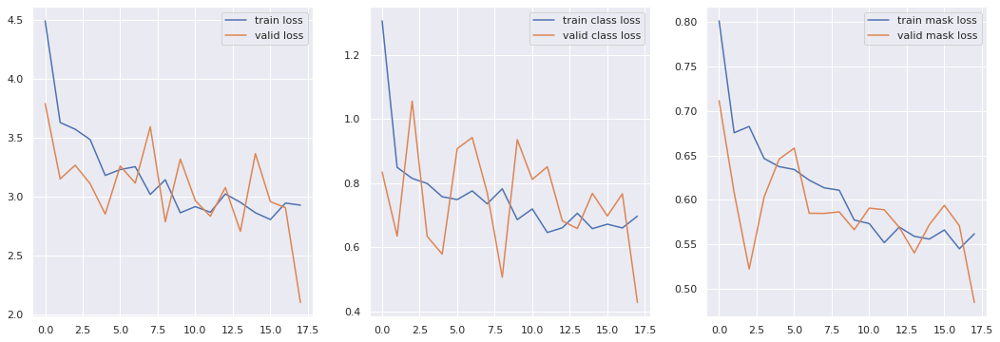

In [73]:
epochs = range(EPOCHS[2])

plt.figure(figsize=(18, 6))

plt.subplot(131)
plt.plot(epochs, history['loss'], label="train loss")
plt.plot(epochs, history['val_loss'], label="valid loss")
plt.legend()
plt.subplot(132)
plt.plot(epochs, history['mrcnn_class_loss'], label="train class loss")
plt.plot(epochs, history['val_mrcnn_class_loss'], label="valid class loss")
plt.legend()
plt.subplot(133)
plt.plot(epochs, history['mrcnn_mask_loss'], label="train mask loss")
plt.plot(epochs, history['val_mrcnn_mask_loss'], label="valid mask loss")
plt.legend()

plt.show()

In [74]:
best_epoch = np.argmin(history["val_loss"]) + 1
print("Best epoch: ", best_epoch)
print("Valid loss: ", history["val_loss"][best_epoch-1])

Best epoch:  18
Valid loss:  2.104258728027344


In [75]:
import glob

In [76]:
glob_list = glob.glob(f'/kaggle/working/class*/mask_rcnn_class_{best_epoch:04d}.h5')
model_path = glob_list[0] if glob_list else ''

In [77]:
sample_df = sample_sub_df

In [78]:
class InferenceConfig(FashionConfig):
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1

In [79]:
inference_config = InferenceConfig()
model = modellib.MaskRCNN(mode='inference', 
                          config=inference_config,
                          model_dir=ROOT_DIR)

assert model_path != '' 
print("Loading weights from ", model_path)
model.load_weights(model_path, by_name=True)

Loading weights from  /kaggle/working/class20230304T0318/mask_rcnn_class_0018.h5
Re-starting from epoch 18


In [80]:
# Convert data to run-length encoding
def to_rle(bits):
    rle = []
    pos = 0
    for bit, group in itertools.groupby(bits):
        group_list = list(group)
        if bit:
            rle.extend([pos, sum(group_list)])
        pos += len(group_list)
    return rle

In [82]:
#fixing overlapping masks
def refine_masks(masks, rois):
    areas = np.sum(masks.reshape(-1, masks.shape[-1]), axis=0)
    mask_index = np.argsort(areas)
    union_mask = np.zeros(masks.shape[:-1], dtype=bool)
    for m in mask_index:
        masks[:, :, m] = np.logical_and(masks[:, :, m], np.logical_not(union_mask))
        union_mask = np.logical_or(masks[:, :, m], union_mask)
    for m in range(masks.shape[-1]):
        mask_pos = np.where(masks[:, :, m]==True)
        if np.any(mask_pos):
            y1, x1 = np.min(mask_pos, axis=1)
            y2, x2 = np.max(mask_pos, axis=1)
            rois[m, :] = [y1, x1, y2, x2]
    return masks, rois

In [83]:
IMAGE_SIZE = 256

In [84]:
def resize_image(image_path):
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (IMAGE_SIZE, IMAGE_SIZE), interpolation=cv2.INTER_AREA)  
    return img

In [85]:
#%%time
#import itertools
#sub_list = []
#missing_count = 0
#for i, row in tqdm(sample_df.iterrows(), total=len(sample_df)):
    #image = resize_image(str(DATA_DIR/'test'/row['ImageId']) + '.jpg')
    #result = model.detect([image])[0]
    #if result['masks'].size > 0:
        #masks, _ = refine_masks(result['masks'], result['rois'])
        #f#or m in range(masks.shape[-1]):
           # mask = masks[:, :, m].ravel(order='F')
            #rle = to_rle(mask)
            #label = result['class_ids'][m] - 1
            #sub_list.append([row['ImageId'], ' '.join(list(map(str, rle))), label, np.NaN])
    #else:
        # The system does not allow missing ids, this is an easy way to fill them 
        #sub_list.append([row['ImageId'], '1 1', 23, np.NaN])
       # missing_count += 1

In [86]:
sample_sub_df.columns

Index(['ImageId', 'EncodedPixels', 'ClassId', 'AttributesIds'], dtype='object')

In [87]:
sample_df.to_csv("submission.csv", index=False)

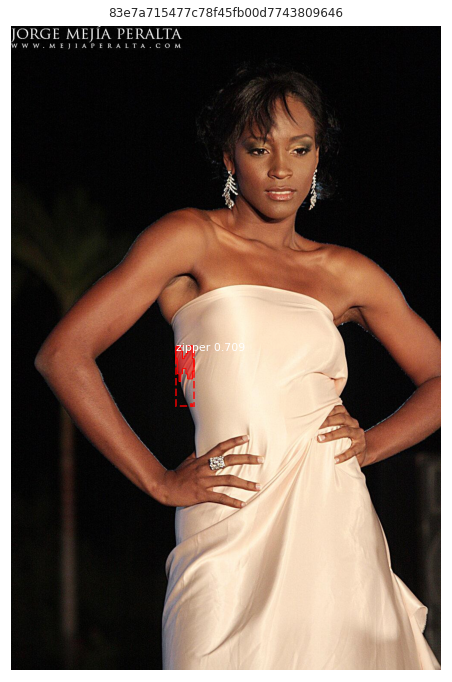

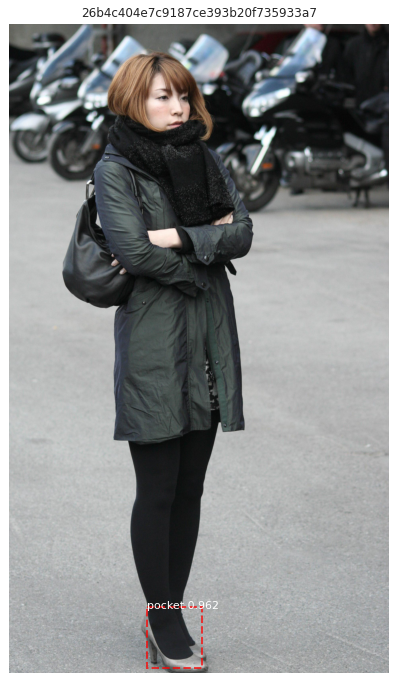


*** No instances to display *** 



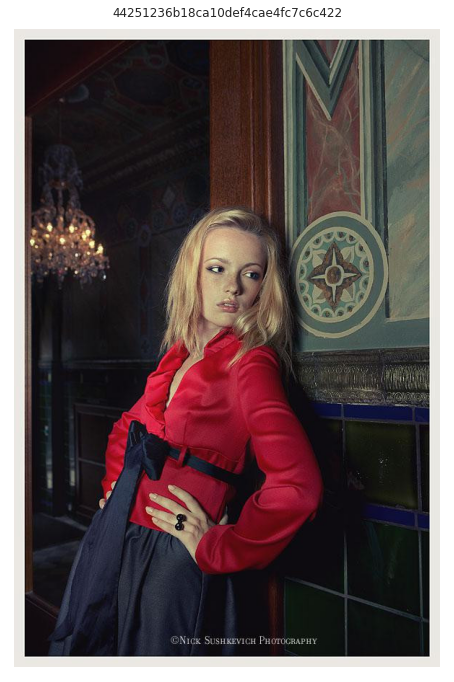


*** No instances to display *** 



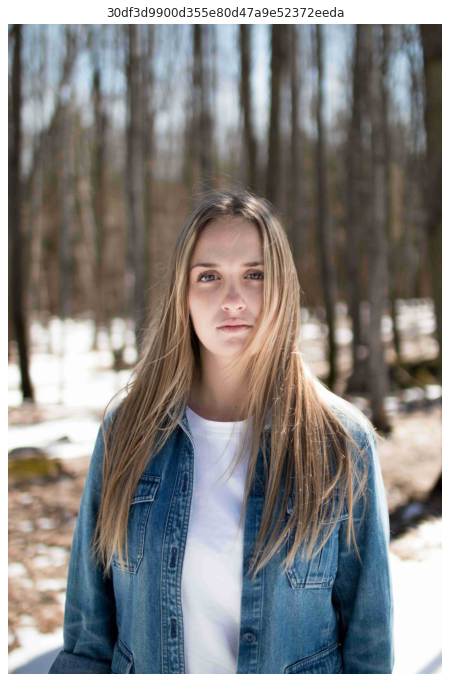

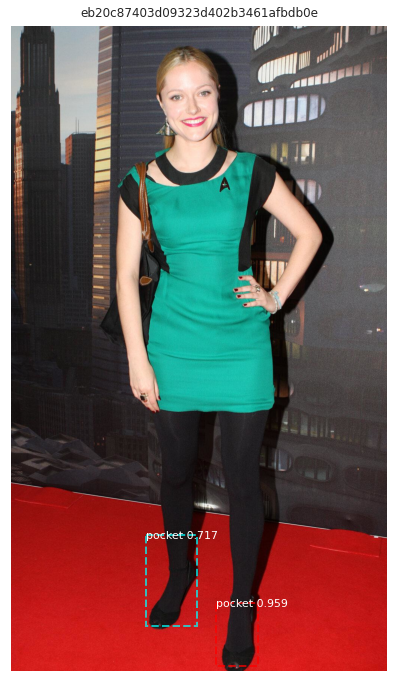

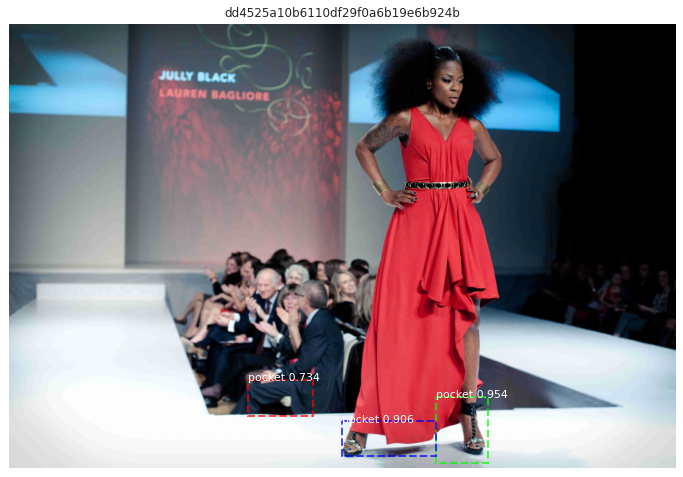

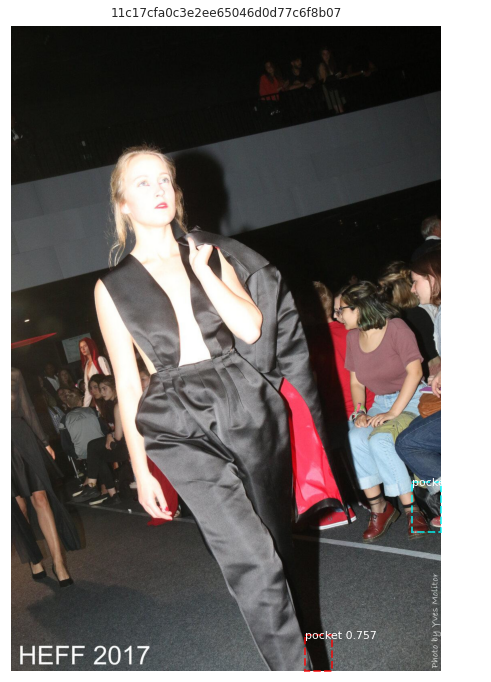

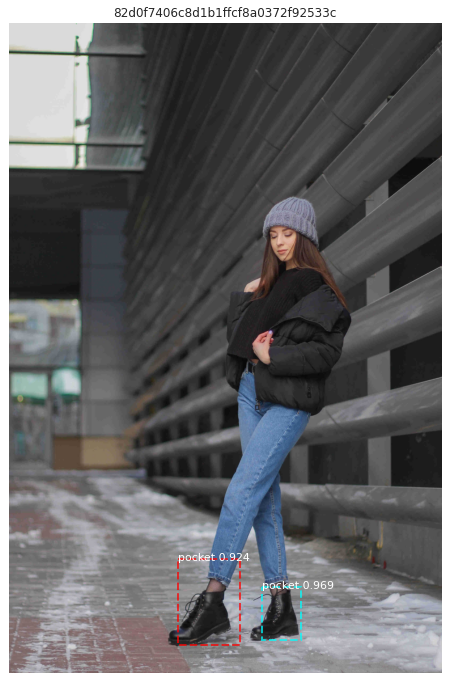

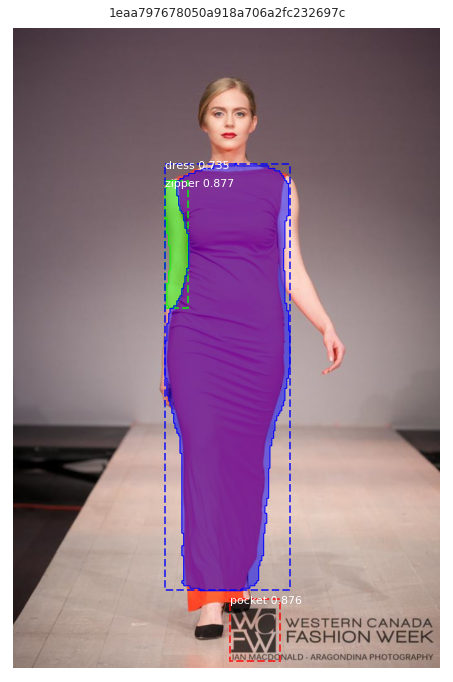

In [89]:
for i in range(9):
    image_id = sample_df.sample()['ImageId'].values[0]
    image_path = str(DATA_DIR/'test'/image_id)+ '.jpg'
    
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    result = model.detect([resize_image(image_path)])
    r = result[0]
    
    if r['masks'].size > 0:
        masks = np.zeros((img.shape[0], img.shape[1], r['masks'].shape[-1]), dtype=np.uint8)
        for m in range(r['masks'].shape[-1]):
            masks[:, :, m] = cv2.resize(r['masks'][:, :, m].astype('uint8'), 
                                        (img.shape[1], img.shape[0]), interpolation=cv2.INTER_NEAREST)
        
        y_scale = img.shape[0]/IMAGE_SIZE
        x_scale = img.shape[1]/IMAGE_SIZE
        rois = (r['rois'] * [y_scale, x_scale, y_scale, x_scale]).astype(int)
        
        masks, rois = refine_masks(masks, rois)
    else:
        masks, rois = r['masks'], r['rois']
        
    visualize.display_instances(img, rois, masks, r['class_ids'],dataset.class_names, 
                                 r['scores'],
                                title=image_id, figsize=(12, 12))

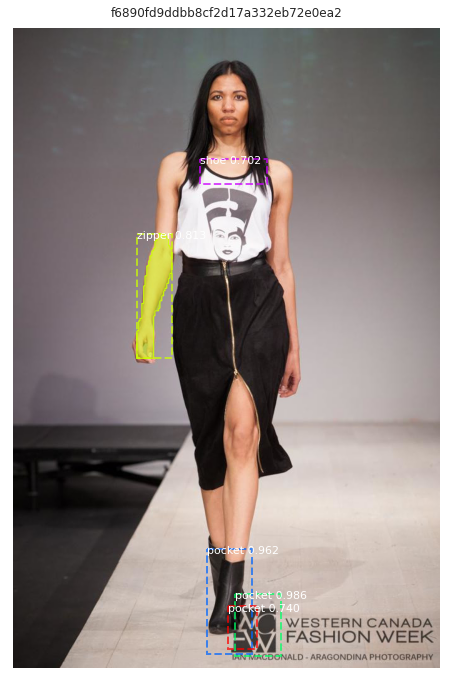

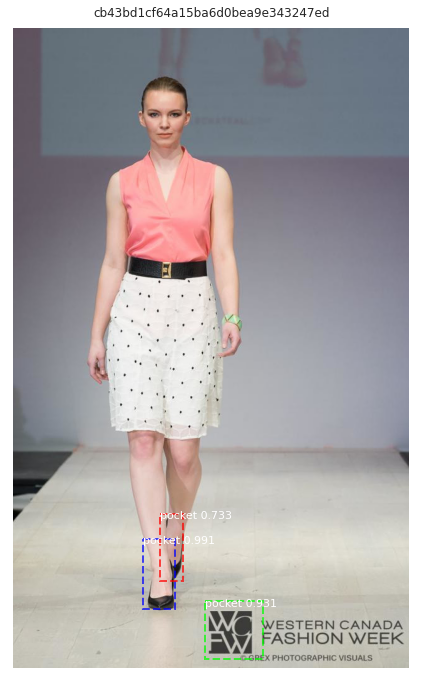

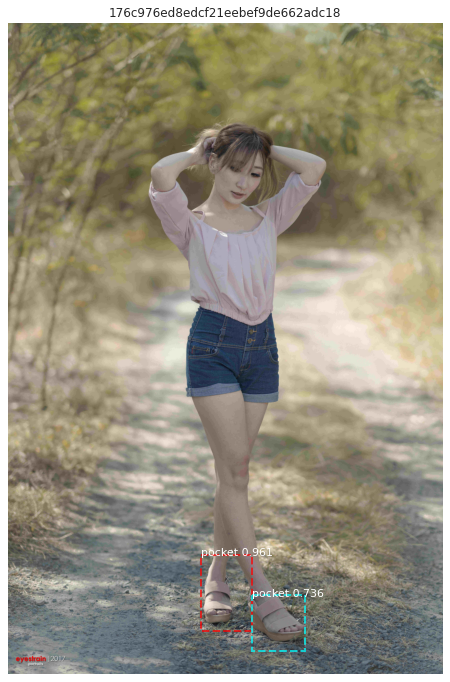

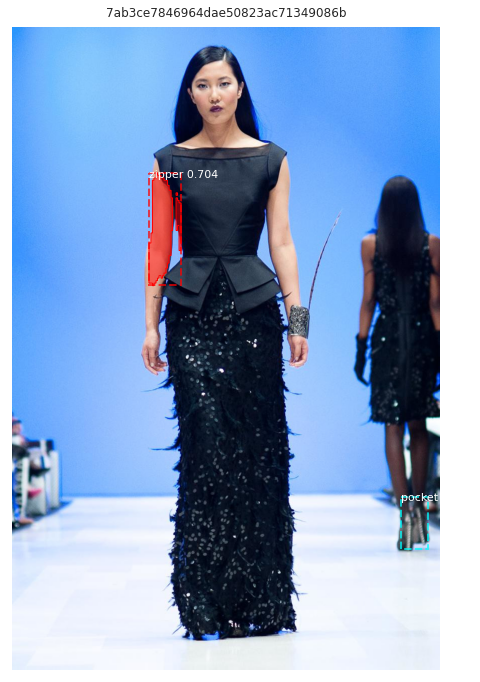

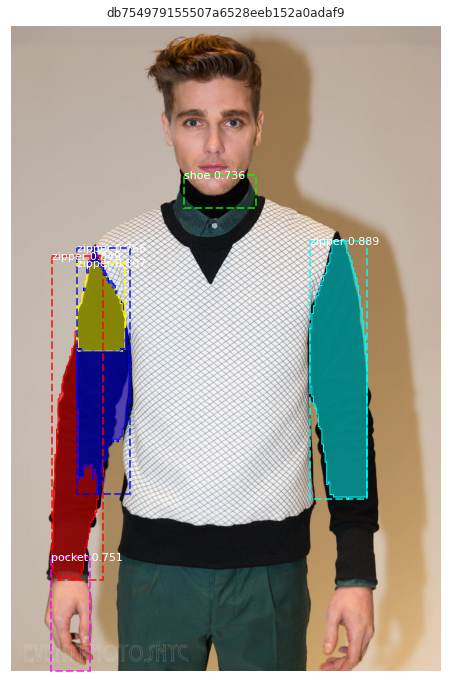


*** No instances to display *** 



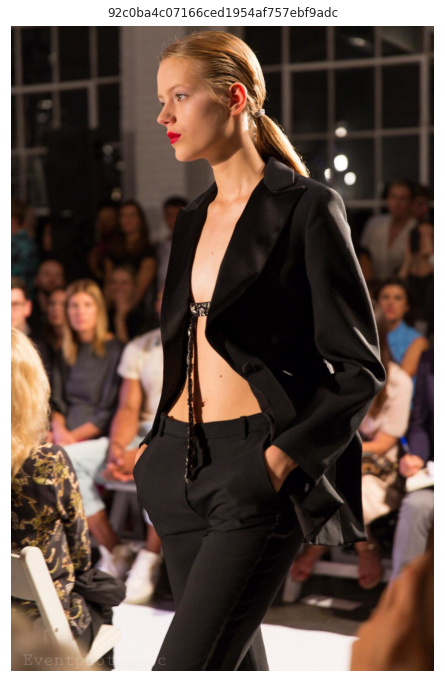


*** No instances to display *** 



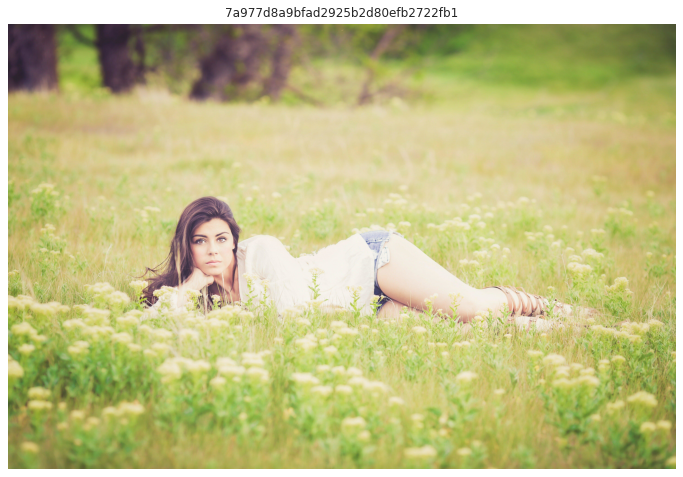

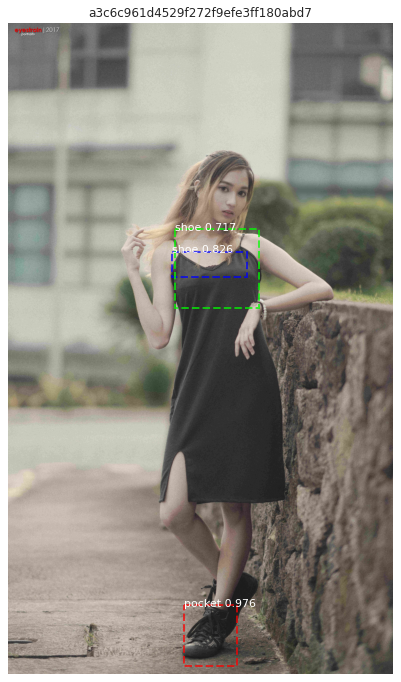

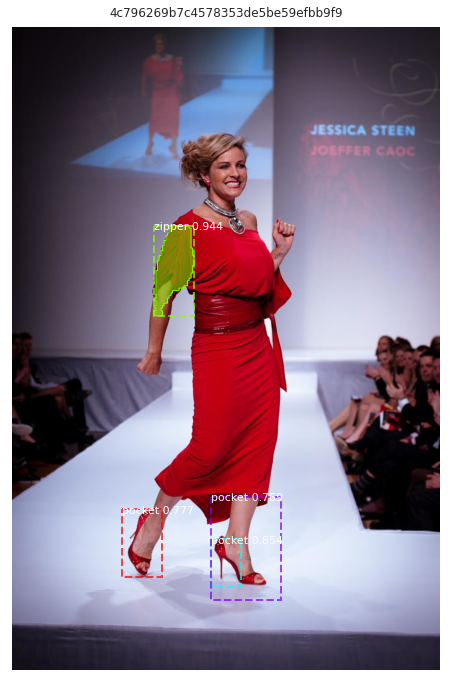

In [90]:
for i in range(9):
    image_id = sample_df.sample()['ImageId'].values[0]
    image_path = str(DATA_DIR/'test'/image_id)+ '.jpg'
    
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    result = model.detect([resize_image(image_path)])
    r = result[0]
    
    if r['masks'].size > 0:
        masks = np.zeros((img.shape[0], img.shape[1], r['masks'].shape[-1]), dtype=np.uint8)
        for m in range(r['masks'].shape[-1]):
            masks[:, :, m] = cv2.resize(r['masks'][:, :, m].astype('uint8'), 
                                        (img.shape[1], img.shape[0]), interpolation=cv2.INTER_NEAREST)
        
        y_scale = img.shape[0]/IMAGE_SIZE
        x_scale = img.shape[1]/IMAGE_SIZE
        rois = (r['rois'] * [y_scale, x_scale, y_scale, x_scale]).astype(int)
        
        masks, rois = refine_masks(masks, rois)
    else:
        masks, rois = r['masks'], r['rois']
        
    visualize.display_instances(img, rois, masks, r['class_ids'],dataset.class_names, 
                                 r['scores'],
                                title=image_id, figsize=(12, 12))

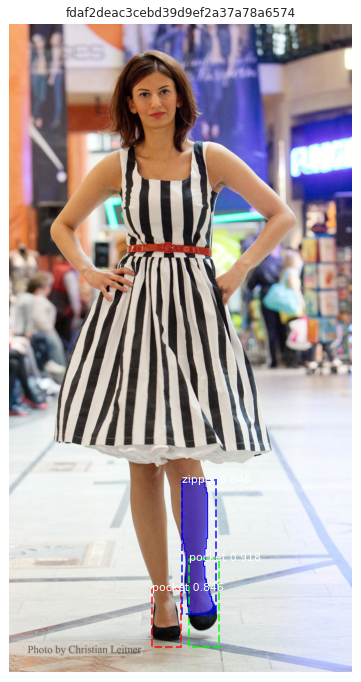

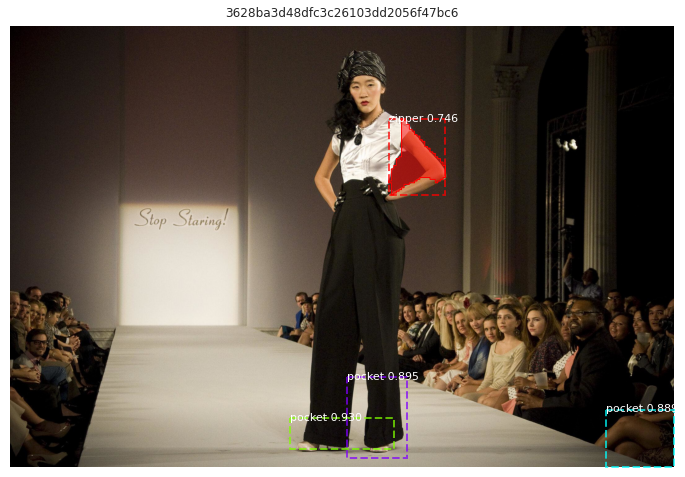


*** No instances to display *** 



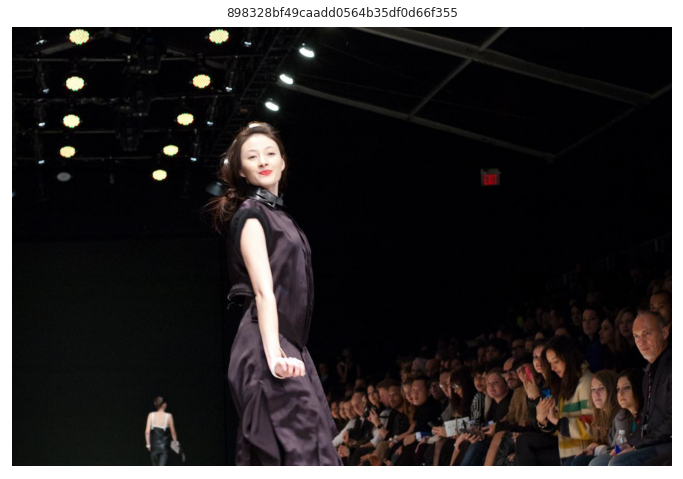

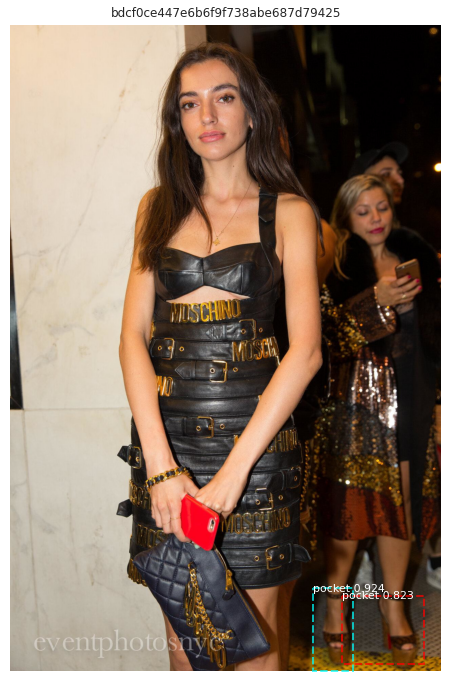

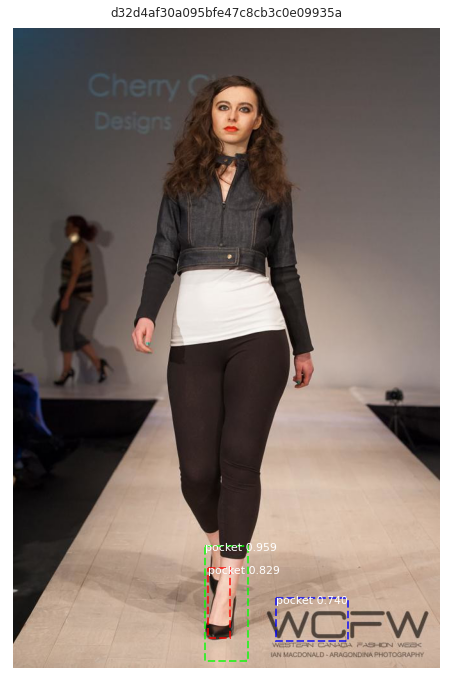


*** No instances to display *** 



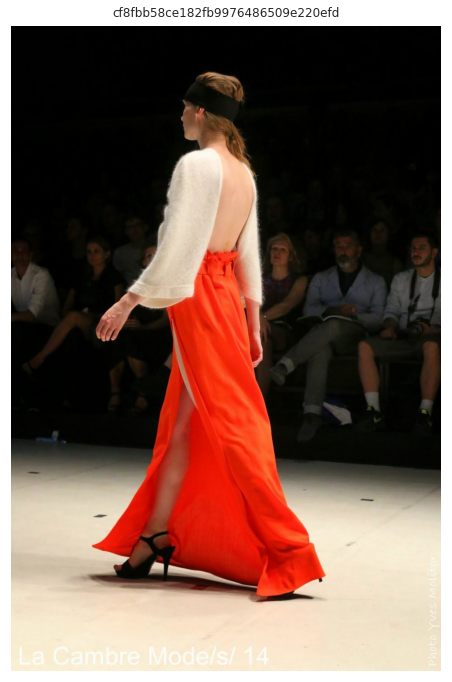

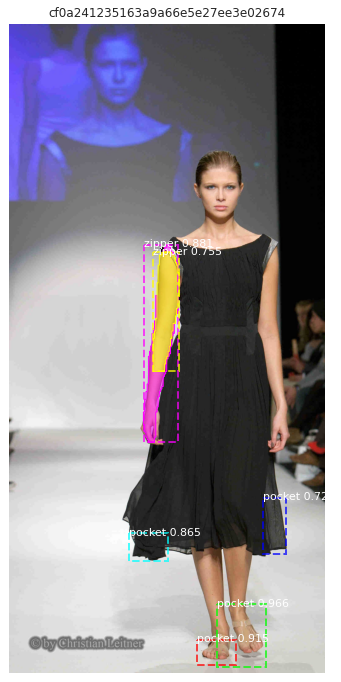


*** No instances to display *** 



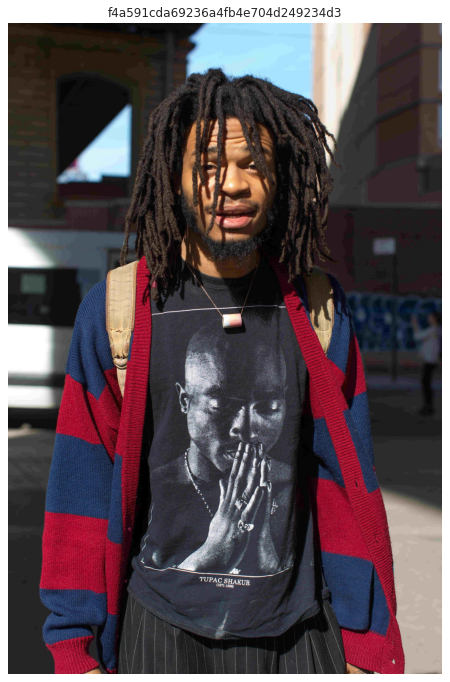

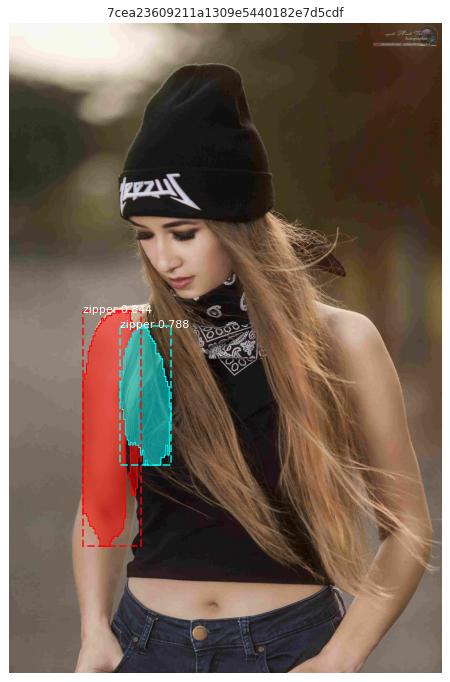

In [91]:
for i in range(9):
    image_id = sample_df.sample()['ImageId'].values[0]
    image_path = str(DATA_DIR/'test'/image_id)+ '.jpg'
    
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    result = model.detect([resize_image(image_path)])
    r = result[0]
    
    if r['masks'].size > 0:
        masks = np.zeros((img.shape[0], img.shape[1], r['masks'].shape[-1]), dtype=np.uint8)
        for m in range(r['masks'].shape[-1]):
            masks[:, :, m] = cv2.resize(r['masks'][:, :, m].astype('uint8'), 
                                        (img.shape[1], img.shape[0]), interpolation=cv2.INTER_NEAREST)
        
        y_scale = img.shape[0]/IMAGE_SIZE
        x_scale = img.shape[1]/IMAGE_SIZE
        rois = (r['rois'] * [y_scale, x_scale, y_scale, x_scale]).astype(int)
        
        masks, rois = refine_masks(masks, rois)
    else:
        masks, rois = r['masks'], r['rois']
        
    visualize.display_instances(img, rois, masks, r['class_ids'],dataset.class_names 
                                , r['scores'],
                                title=image_id, figsize=(12, 12))

1
Processing 1 images
image                    shape: (667, 1000, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 256, 256, 3)      min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 59)               min:    0.00000  max: 1000.00000  float64
anchors                  shape: (1, 16368, 4)         min:   -0.35494  max:    1.10396  float32


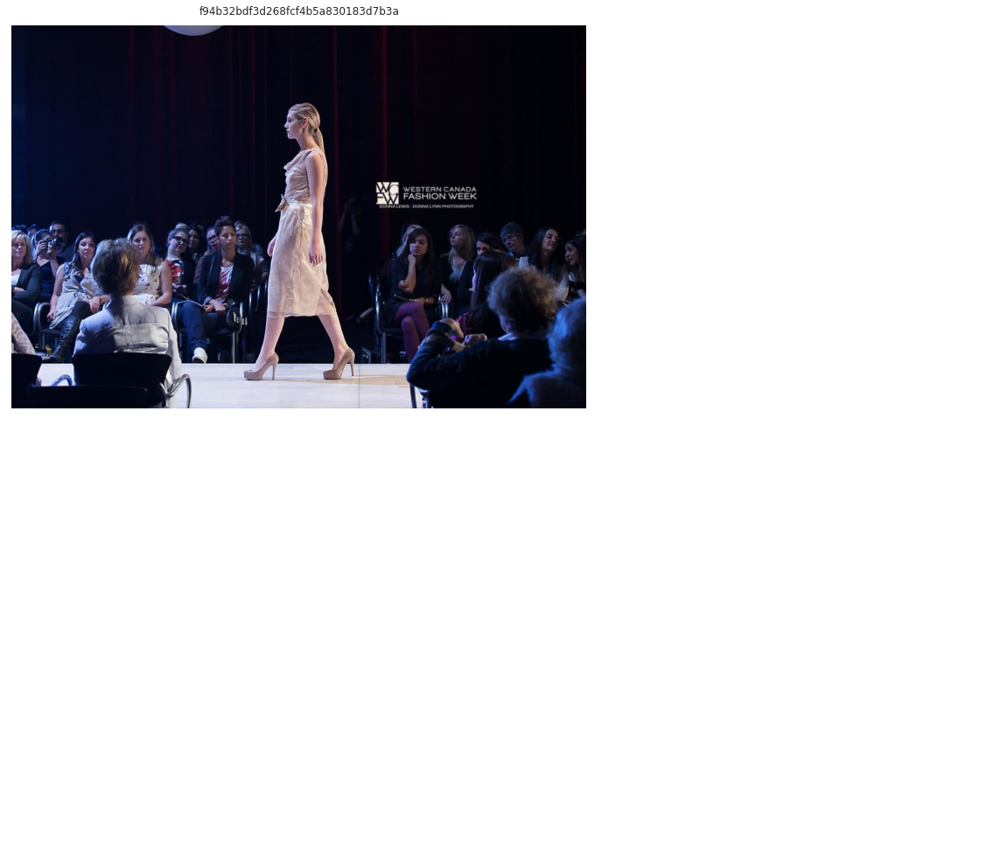

1
Processing 1 images
image                    shape: (753, 500, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 256, 256, 3)      min: -123.70000  max:  149.10000  float64
image_metas              shape: (1, 59)               min:    0.00000  max:  753.00000  float64
anchors                  shape: (1, 16368, 4)         min:   -0.35494  max:    1.10396  float32


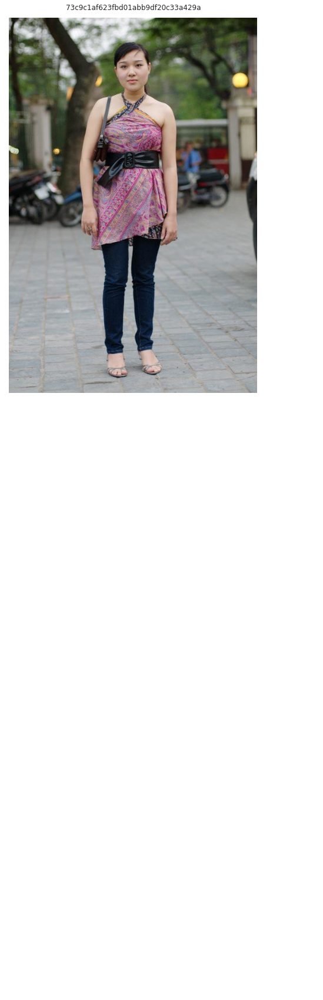

1
Processing 1 images
image                    shape: (1000, 667, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 256, 256, 3)      min: -123.70000  max:  150.10000  float64
image_metas              shape: (1, 59)               min:    0.00000  max: 1000.00000  float64
anchors                  shape: (1, 16368, 4)         min:   -0.35494  max:    1.10396  float32

*** No instances to display *** 



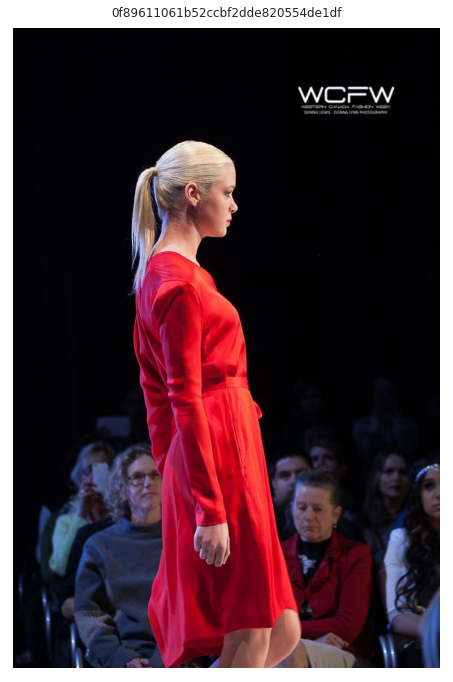

1
Processing 1 images
image                    shape: (2224, 1643, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 256, 256, 3)      min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 59)               min:    0.00000  max: 2224.00000  float64
anchors                  shape: (1, 16368, 4)         min:   -0.35494  max:    1.10396  float32


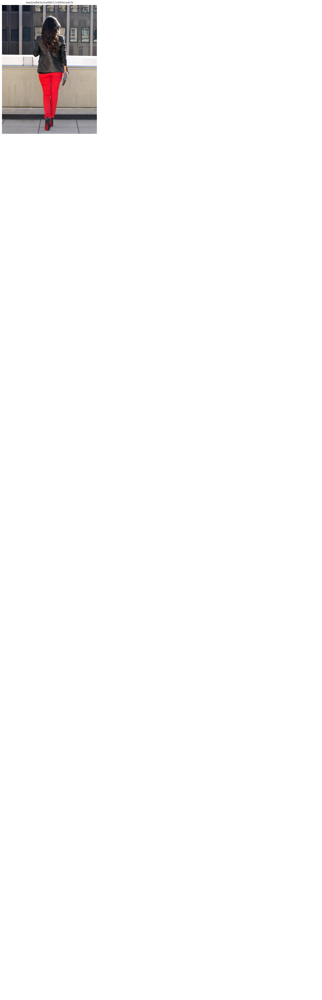

1
Processing 1 images
image                    shape: (1800, 1201, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 256, 256, 3)      min: -123.70000  max:  134.10000  float64
image_metas              shape: (1, 59)               min:    0.00000  max: 1800.00000  float64
anchors                  shape: (1, 16368, 4)         min:   -0.35494  max:    1.10396  float32


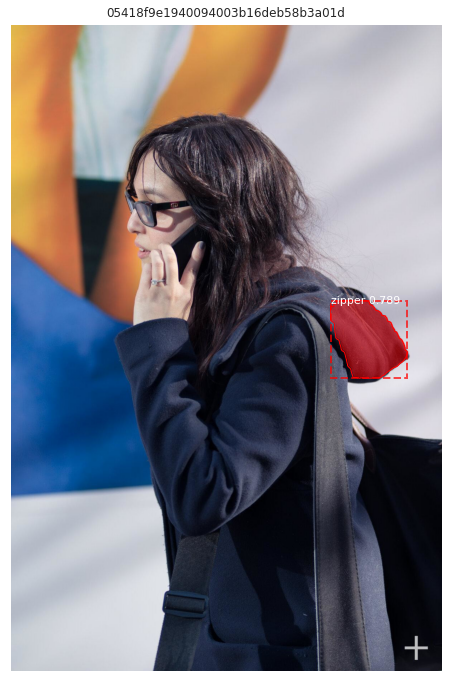

1
Processing 1 images
image                    shape: (1000, 665, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 256, 256, 3)      min: -123.70000  max:  150.10000  float64
image_metas              shape: (1, 59)               min:    0.00000  max: 1000.00000  float64
anchors                  shape: (1, 16368, 4)         min:   -0.35494  max:    1.10396  float32


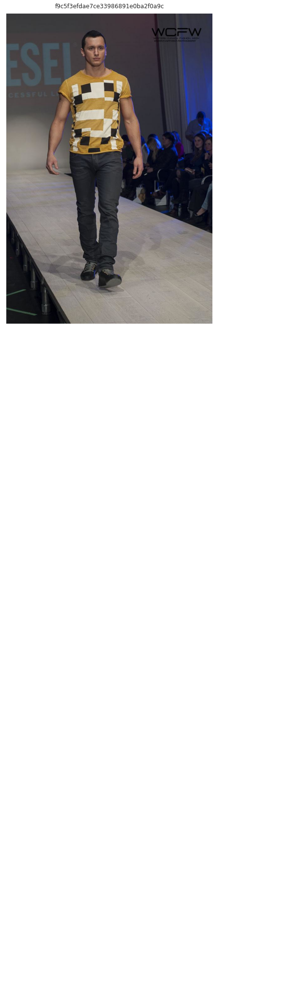

1
Processing 1 images
image                    shape: (1024, 633, 3)        min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 256, 256, 3)      min: -123.70000  max:  143.10000  float64
image_metas              shape: (1, 59)               min:    0.00000  max: 1024.00000  float64
anchors                  shape: (1, 16368, 4)         min:   -0.35494  max:    1.10396  float32


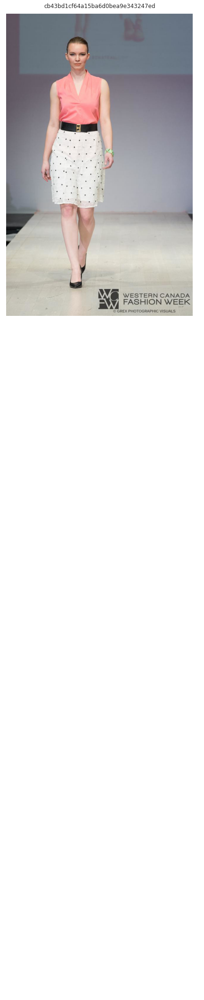

1
Processing 1 images
image                    shape: (753, 500, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 256, 256, 3)      min: -123.70000  max:  147.10000  float64
image_metas              shape: (1, 59)               min:    0.00000  max:  753.00000  float64
anchors                  shape: (1, 16368, 4)         min:   -0.35494  max:    1.10396  float32


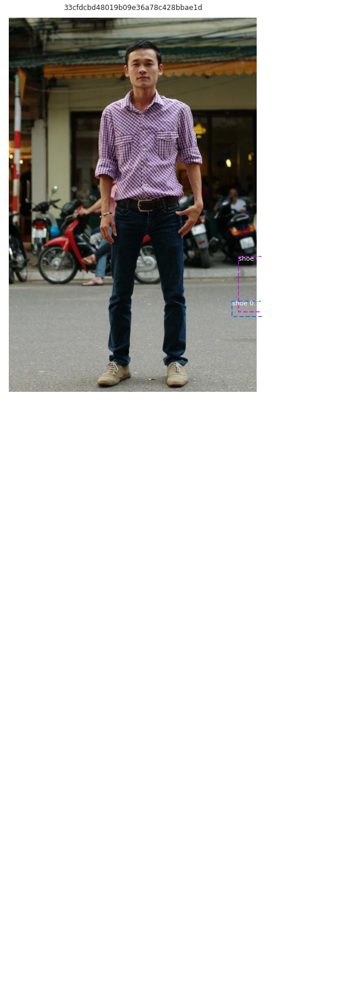

1
Processing 1 images
image                    shape: (3409, 5113, 3)       min:    0.00000  max:  244.00000  uint8
molded_images            shape: (1, 256, 256, 3)      min: -123.70000  max:  121.10000  float64
image_metas              shape: (1, 59)               min:    0.00000  max: 5113.00000  float64
anchors                  shape: (1, 16368, 4)         min:   -0.35494  max:    1.10396  float32

*** No instances to display *** 



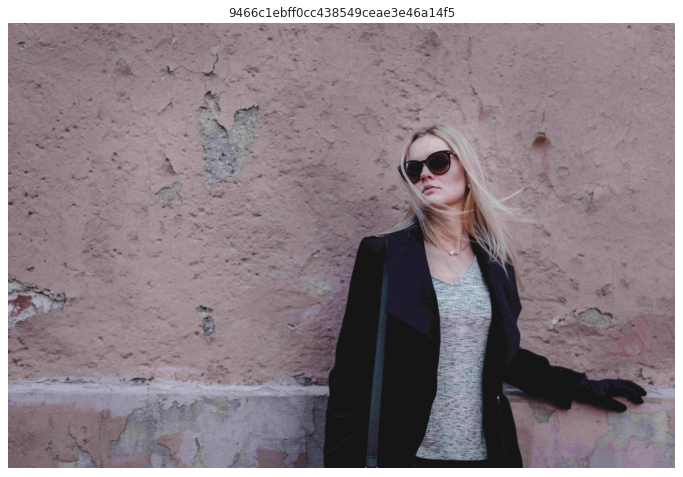

In [92]:
import matplotlib.image as mpimg

for i in range(9):
    image_id = sample_df.sample()['ImageId'].values[0]
    image_path = str(DATA_DIR/'test'/image_id)+ '.jpg'
    
    img =mpimg.imread(image_path)
    print(len([img]))
    
    result = model.detect([img], verbose=1)
    r = result[0]
    if r['masks'].size > 0:
        masks = np.zeros((img.shape[0], img.shape[1], r['masks'].shape[-1]), dtype=np.uint8)
        for m in range(r['masks'].shape[-1]):
            masks[:, :, m] = cv2.resize(r['masks'][:, :, m].astype('uint8'), 
                                        (img.shape[1], img.shape[0]), interpolation=cv2.INTER_NEAREST)
        
        y_scale = img.shape[0]/IMAGE_SIZE
        x_scale = img.shape[1]/IMAGE_SIZE
        rois = (r['rois'] * [y_scale, x_scale, y_scale, x_scale]).astype(int)
        
        masks, rois = refine_masks(masks, rois)
    else:
        masks, rois = r['masks'], r['rois']
    
   
        
    visualize.display_instances(img, rois, masks, r['class_ids'],dataset.class_names,
                                r['scores'],
                                title=image_id, figsize=(12, 12))